In [4]:
import pandas as pd 
import matplotlib.pyplot as plt
import time
# import seaborn as sns
from pyevmasm import disassemble_hex
from binascii import unhexlify
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.model_selection import train_test_split
import lightgbm as lgb
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.layers import Embedding
import numpy as np
import lightgbm as lgb
from sklearn.model_selection import GridSearchCV, cross_val_predict
from sklearn.metrics import classification_report, roc_auc_score, roc_curve, auc

2024-10-26 16:41:09.001751: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-10-26 16:41:09.179896: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-10-26 16:41:09.253386: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-10-26 16:41:09.272986: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-10-26 16:41:09.406940: I tensorflow/core/platform/cpu_feature_guar

# Helper Functions

In [2]:
import lightgbm as lgb
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report, roc_auc_score, roc_curve, accuracy_score
import matplotlib.pyplot as plt

def simple_hypertune_lgbm(X_train, X_test, y_train, y_test):
    # Define the parameter grid for tuning
    param_grid = {
        'learning_rate': [0.01, 0.1, 0.2],        # Small set of learning rates
        'max_depth': [2, 3, 5, 8],                # Maximum depth of the tree
        'lambda_l2': [0, 0.1, 1.0],               # L2 regularization
        'n_estimators': [100, 150, 200, 300]      # Number of boosting rounds
    }

    # Initialize the LGBM classifier
    model = lgb.LGBMClassifier(objective='binary', random_state=42)

    # Set up GridSearchCV with 5-fold cross-validation
    grid_search = GridSearchCV(estimator=model, param_grid=param_grid, 
                               cv=5, scoring='recall', n_jobs=-1, verbose=1)

    # Fit the model
    grid_search.fit(X_train, y_train)

    # Get the best model from grid search
    best_model = grid_search.best_estimator_

    # Predict on training data to calculate training accuracy
    y_train_pred = best_model.predict(X_train)
    train_accuracy = accuracy_score(y_train, y_train_pred)
    
    # Predict on test data
    y_pred = best_model.predict(X_test)
    test_accuracy = accuracy_score(y_test, y_pred)
    
    # Predict probabilities for ROC-AUC curve
    y_pred_proba = best_model.predict_proba(X_test)[:, 1]  # Probability estimates for ROC-AUC

    # Print training and test accuracies
    print(f"Training Accuracy: {train_accuracy:.4f}")
    print(f"Test Accuracy: {test_accuracy:.4f}")

    # Print the best hyperparameters
    print("Best Hyperparameters found by GridSearchCV:")
    print(grid_search.best_params_)

    # Calculate recall, precision, etc. using classification report
    target_names = ['illicit', 'reputable']  # Renaming target classes
    report = classification_report(y_test, y_pred, target_names=target_names, digits=4)

    # Print classification report
    print("Classification Report:")
    print(report)

    # Compute ROC-AUC score and draw the curve
    roc_auc = roc_auc_score(y_test, y_pred_proba)
    fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)
    plt.figure()
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.4f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend(loc='lower right')
    plt.show()

    # Return the best model and best parameters
    return best_model, grid_search.best_params_

In [5]:
import re
def bytecode_to_opcode(bytecode):
    # If bytecode starts with '0x', remove '0x'
    if bytecode.startswith('0x'):
        bytecode = bytecode[2:]
    
    bytecode = re.sub(r'[^0-9a-fA-F]', '', bytecode)
    opcode = disassemble_hex(bytecode)
    return opcode

def simplify_opcode(opcode_sequence):
    opcode_categories = {
        'ARITH': ['ADD', 'MUL', 'SUB', 'DIV', 'SDIV', 'SMOD', 'MOD', 'ADDMOD', 'MULMOD', 'EXP', 'SIGNEXTEND'],
        'COMPARE': ['LT', 'GT', 'SLT', 'SGT'],
        'LOGIC': ['AND', 'OR', 'XOR', 'NOT'],
        'MEMORY': ['MLOAD', 'MSTORE', 'SLOAD', 'SSTORE', 'MSIZE'],
        'RETURN': ['RETURN', 'REVERT', 'RETURNDATASIZE', 'RETURNDATACOPY'],
        'PUSH': ['PUSH1', 'PUSH2', 'PUSH3', 'PUSH4', 'PUSH5', 'PUSH6', 'PUSH7', 'PUSH8', 'PUSH9', 'PUSH10',
                  'PUSH11', 'PUSH12', 'PUSH13', 'PUSH14', 'PUSH15', 'PUSH16', 'PUSH17', 'PUSH18', 'PUSH19', 'PUSH20',
                  'PUSH21', 'PUSH22', 'PUSH23', 'PUSH24', 'PUSH25', 'PUSH26', 'PUSH27', 'PUSH28', 'PUSH29', 'PUSH30', 'PUSH31', 'PUSH32'],
        'DUP': ['DUP1', 'DUP2', 'DUP3', 'DUP4', 'DUP5', 'DUP6', 'DUP7', 'DUP8', 'DUP9', 'DUP10',
                'DUP11', 'DUP12', 'DUP13', 'DUP14', 'DUP15', 'DUP16'],
        'SWAP': ['SWAP1', 'SWAP2', 'SWAP3', 'SWAP4', 'SWAP5', 'SWAP6', 'SWAP7', 'SWAP8', 'SWAP9', 'SWAP10',
                 'SWAP11', 'SWAP12', 'SWAP13', 'SWAP14', 'SWAP15', 'SWAP16'],
        'LOG': ['LOG0', 'LOG1', 'LOG2', 'LOG3', 'LOG4']
    }

    simplified_opcode_sequence = []
    for opcode in opcode_sequence.split("\n"):
        opcode = opcode.strip()
        for category, opcodes in opcode_categories.items():
            if any(opcode.startswith(op) for op in opcodes):
                simplified_opcode_sequence.append(category)
                break
        else:
            simplified_opcode_sequence.append(opcode)

    return "\n".join(simplified_opcode_sequence)

# Reading Data and Preprocessinbg

In [6]:
df = pd.read_csv("sc_code_analysis.csv")
df = df.drop(columns=['source_code'], axis=1)
df = df[['address', 'byte_code', 'is_reputable']]

df['opcode'] = df['byte_code'].apply(bytecode_to_opcode)
df['opcode'] = df['opcode'].apply(simplify_opcode)
X = df['opcode']
y = df['is_reputable']

# Generating Embeddings

In [7]:
# Assuming X contains your opcode sequences
opcode_sequences = X

# Tokenize the sequences
tokenizer = Tokenizer()
tokenizer.fit_on_texts(opcode_sequences)
sequences = tokenizer.texts_to_sequences(opcode_sequences)

# Get the vocabulary size
vocab_size = len(tokenizer.word_index) + 1

# Pad sequences to the same length
max_length = max(len(seq) for seq in sequences)
sequences_padded = pad_sequences(sequences, maxlen=max_length, padding='post')

# Define the Word2Vec model using the Embedding layer
embedding_dim = 50  # Size of the embedding vector
embedding_model = tf.keras.Sequential([
    Embedding(input_dim=vocab_size, output_dim=embedding_dim, input_length=max_length),
])

# Compile the model (no actual training is required for this task)
embedding_model.compile('rmsprop', 'mse')

# Define batch processing parameters
batch_size = 50  # Adjusted based on GPU memory capacity
num_batches = int(np.ceil(len(sequences_padded) / batch_size))

# List to store embeddings
opcode_embeddings = []

# Process each batch
for i in range(num_batches):
    start_idx = i * batch_size
    end_idx = min((i + 1) * batch_size, len(sequences_padded))
    
    # Get the batch of padded sequences
    batch_sequences_padded = sequences_padded[start_idx:end_idx]
    
    # Generate embeddings for the current batch
    batch_embeddings = embedding_model.predict(batch_sequences_padded)
    
    # Compute the mean embedding for each sequence
    batch_mean_embeddings = np.mean(batch_embeddings, axis=1)
    
    # Store the result
    opcode_embeddings.append(batch_mean_embeddings)

# Concatenate all batch embeddings
opcode_embeddings = np.vstack(opcode_embeddings)

/home/malikcyrus/anaconda3/envs/code-env/lib/python3.12/site-packages/keras/src/layers/core/embedding.py:90: UserWarning: Argument `input_length` is deprecated. Just remove it.
  warnings.warn(
I0000 00:00:1729953771.663449  115540 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1729953771.797009  115540 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1729953771.797082  115540 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:1729953771.800294  115540 cuda_executor.cc:1001] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
I0000 00:00:17

1/2 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step

I0000 00:00:1729953772.444548  128905 service.cc:146] XLA service 0x7fc8dc002840 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1729953772.444599  128905 service.cc:154]   StreamExecutor device (0): NVIDIA GeForce RTX 3060 Ti, Compute Capability 8.6
2024-10-26 16:42:52.499766: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:531] Loaded cuDNN version 8907
I0000 00:00:1729953772.642807  128905 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━

In [8]:
embedding_columns = [f'embedding_{i+1}' for i in range(opcode_embeddings.shape[1])]
embeddings_df = pd.DataFrame(opcode_embeddings, columns=embedding_columns)

# Step 2: Add the 'address' column from the original dataframe
# Assuming the addresses in `df` are in the same order as the embeddings
embeddings_df['address'] = df['address'].values

# Step 3: Reorder columns to have 'address' first
embeddings_df = embeddings_df[['address'] + embedding_columns]

In [9]:
X = opcode_embeddings
y = df['is_reputable']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

# Train and Validation - No Augmentation

Fitting 5 folds for each of 144 candidates, totalling 720 fits
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Info] Number of positive: 1728, number of negative: 107
[LightGBM] [Info] Number of positive: 1728, number of negative: 107
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.010759 second

/home/malikcyrus/anaconda3/envs/code-env/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/malikcyrus/anaconda3/envs/code-env/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/malikcyrus/anaconda3/envs/code-env/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f

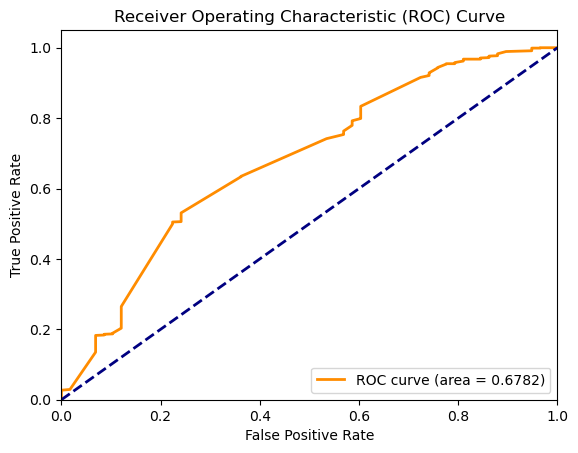

[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0


In [10]:
# Assuming you already have X_train, X_test, y_train, y_test
best_model, best_params = simple_hypertune_lgbm(X_train, X_test, y_train, y_test)

# Now you can use `best_model` to make predictions
y_pred = best_model.predict(X_test)

In [103]:
y.value_counts()

is_reputable
1    3085
0     191
Name: count, dtype: int64

# Resampling - SMOTE / ADASYN

In [14]:
def simple_hypertune_lgbm_resampling(X_train, y_train):
    # Define the parameter grid for tuning
    param_grid = {
        'learning_rate': [0.01, 0.1, 0.2],        # Small set of learning rates
        'max_depth': [2, 3, 5, 8],                # Maximum depth of the tree
        'lambda_l2': [0, 0.1, 1.0],               # L2 regularization
        'n_estimators': [100, 150, 200, 300]      # Number of boosting rounds
    }

    # Initialize the LGBM classifier
    model = lgb.LGBMClassifier(objective='binary', random_state=42)

    # Set up GridSearchCV with 5-fold cross-validation
    grid_search = GridSearchCV(estimator=model, param_grid=param_grid, 
                               cv=5, scoring='recall', n_jobs=-1, verbose=1)

    # Fit the model
    grid_search.fit(X_train, y_train)

    # Get the best model from grid search
    best_model = grid_search.best_estimator_

    # Return the best model and best parameters
    return best_model

Fitting 5 folds for each of 144 candidates, totalling 720 fits


[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Info] Number of positive: 1728, number of negative: 1728
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003757 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 12750
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Info] Number of data points in the train set: 3456, number

/home/malikcyrus/anaconda3/envs/code-env/lib/python3.12/site-packages/numpy/ma/core.py:2820: RuntimeWarning: invalid value encountered in cast
  _data = np.array(data, dtype=dtype, copy=copy,


[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Info] Number of positive: 2160, number of negative: 2160
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002171 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12749
[LightGBM] [Info] Number of data points in the train set: 4320, number of used features: 50
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

/home/malikcyrus/anaconda3/envs/code-env/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/malikcyrus/anaconda3/envs/code-env/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/home/malikcyrus/anaconda3/envs/code-env/lib/python3.12/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f

[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Warning] lambda_l2 is set=0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0
[LightGBM] [Info] Number of positive: 2160, number of negative: 2121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000660 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12750
[LightGBM] [Info] Number of data points in the train set: 4281, number of used features: 50
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504555 -> initscore=0.018221
[LightGBM] [Info] Start training from score 0.018221
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM]

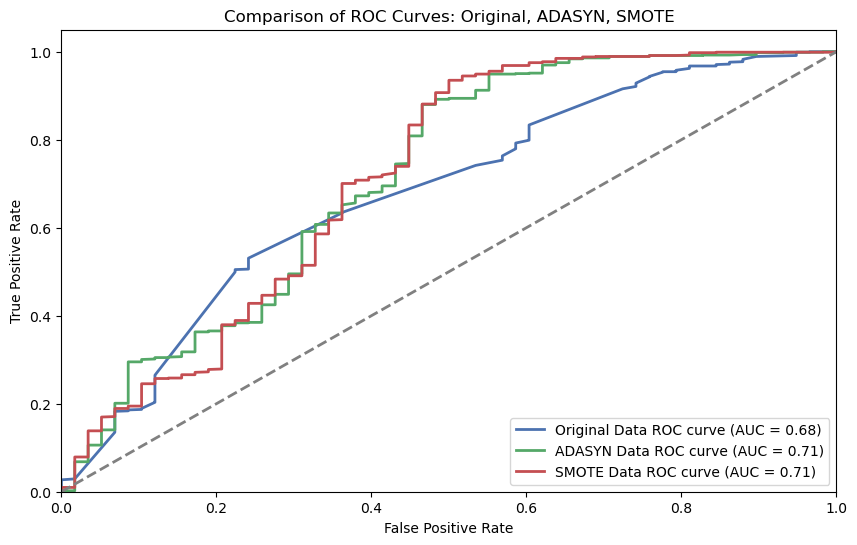

Original Data Classification Report:
 {'0': {'precision': 0.0, 'recall': 0.0, 'f1-score': 0.0, 'support': 58.0}, '1': {'precision': 0.940996948118006, 'recall': 1.0, 'f1-score': 0.9696016771488469, 'support': 925.0}, 'accuracy': 0.940996948118006, 'macro avg': {'precision': 0.470498474059003, 'recall': 0.5, 'f1-score': 0.48480083857442346, 'support': 983.0}, 'weighted avg': {'precision': 0.8854752563674014, 'recall': 0.940996948118006, 'f1-score': 0.9123922190871652, 'support': 983.0}}
ADASYN Data Classification Report:
 {'0': {'precision': 0.3333333333333333, 'recall': 0.3793103448275862, 'f1-score': 0.3548387096774194, 'support': 58.0}, '1': {'precision': 0.960741548527808, 'recall': 0.9524324324324325, 'f1-score': 0.9565689467969598, 'support': 925.0}, 'accuracy': 0.9186164801627671, 'macro avg': {'precision': 0.6470374409305707, 'recall': 0.6658713886300094, 'f1-score': 0.6557038282371896, 'support': 983.0}, 'weighted avg': {'precision': 0.9237225490554993, 'recall': 0.918616480162

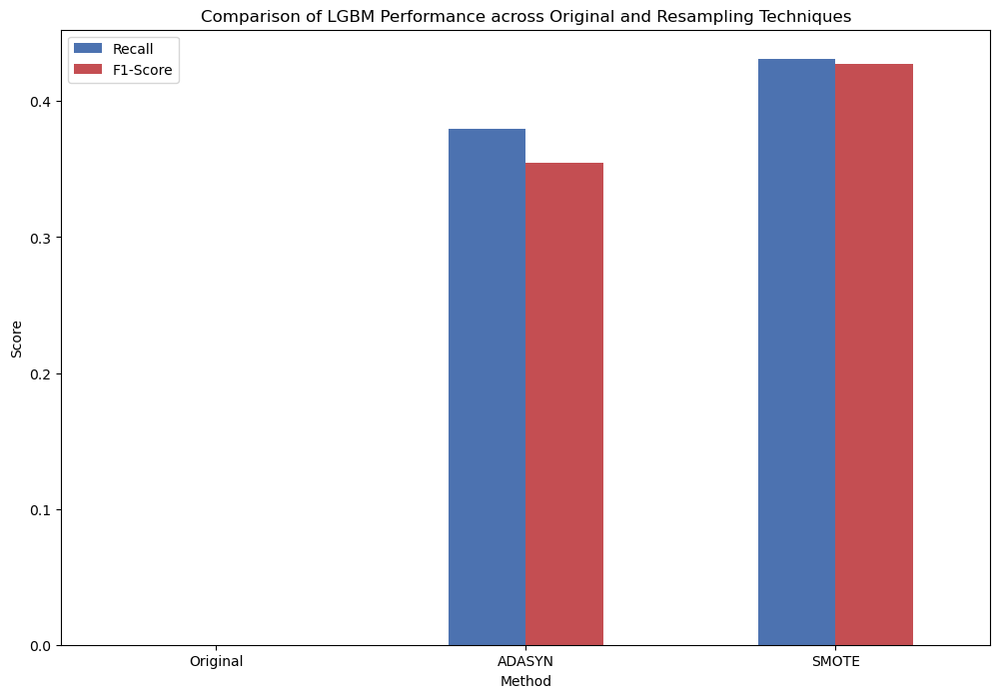

In [30]:
import lightgbm as lgb
from imblearn.over_sampling import SMOTE, ADASYN
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc, classification_report, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Apply ADASYN to the training data
adasyn = ADASYN(random_state=42)
X_train_adasyn, y_train_adasyn = adasyn.fit_resample(X_train, y_train)

# Apply SMOTE to the training data
smote = SMOTE(random_state=42)
X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

# Initialize the LightGBM model with the specified parameters
lgbm_model_smote = simple_hypertune_lgbm_resampling(X_train_smote, y_train_smote)
lgbm_model_adasyn = simple_hypertune_lgbm_resampling(X_train_adasyn, y_train_adasyn)

y_test_pred_proba_original = best_model.predict_proba(X_test)[:, 1]
roc_auc_original = auc(*roc_curve(y_test, y_test_pred_proba_original)[:2])
classification_report_original = classification_report(y_test, best_model.predict(X_test), output_dict=True)
conf_matrix_original = confusion_matrix(y_test, best_model.predict(X_test))

# Train on ADASYN data
lgbm_model_adasyn.fit(X_train_adasyn, y_train_adasyn)
y_test_pred_proba_adasyn = lgbm_model_adasyn.predict_proba(X_test)[:, 1]
roc_auc_adasyn = auc(*roc_curve(y_test, y_test_pred_proba_adasyn)[:2])
classification_report_adasyn = classification_report(y_test, lgbm_model_adasyn.predict(X_test), output_dict=True)
conf_matrix_adasyn = confusion_matrix(y_test, lgbm_model_adasyn.predict(X_test))

# Train on SMOTE data
lgbm_model_smote.fit(X_train_smote, y_train_smote)
y_test_pred_proba_smote = lgbm_model_smote.predict_proba(X_test)[:, 1]
roc_auc_smote = auc(*roc_curve(y_test, y_test_pred_proba_smote)[:2])
classification_report_smote = classification_report(y_test, lgbm_model_smote.predict(X_test), output_dict=True)
conf_matrix_smote = confusion_matrix(y_test, lgbm_model_smote.predict(X_test))

# Plot ROC Curves
plt.figure(figsize=(10, 6))
plt.plot(*roc_curve(y_test, y_test_pred_proba_original)[:2], color='#4C72B0', lw=2, label=f'Original Data ROC curve (AUC = {roc_auc_original:.2f})')
plt.plot(*roc_curve(y_test, y_test_pred_proba_adasyn)[:2], color='#55A868', lw=2, label=f'ADASYN Data ROC curve (AUC = {roc_auc_adasyn:.2f})')
plt.plot(*roc_curve(y_test, y_test_pred_proba_smote)[:2], color='#C44E52', lw=2, label=f'SMOTE Data ROC curve (AUC = {roc_auc_smote:.2f})')
plt.plot([0, 1], [0, 1], color='grey', lw=2, linestyle='--')

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Comparison of ROC Curves: Original, ADASYN, SMOTE')
plt.legend(loc="lower right")
plt.show()

# Create a DataFrame to compare metrics
metrics_comparison = pd.DataFrame({
    'Method': ['Original', 'ADASYN', 'SMOTE'],
    'Recall': [classification_report_original['0']['recall'], classification_report_adasyn['0']['recall'], classification_report_smote['0']['recall']],
    'F1-Score': [classification_report_original['0']['f1-score'], classification_report_adasyn['0']['f1-score'], classification_report_smote['0']['f1-score']],
})

# Print classification reports for detailed evaluation
print("Original Data Classification Report:\n", classification_report_original)
print("ADASYN Data Classification Report:\n", classification_report_adasyn)
print("SMOTE Data Classification Report:\n", classification_report_smote)

# Print confusion matrices
print("Original Data Confusion Matrix:\n", conf_matrix_original)
print("ADASYN Data Confusion Matrix:\n", conf_matrix_adasyn)
print("SMOTE Data Confusion Matrix:\n", conf_matrix_smote)

# Custom muted color palette
colors = ['#4C72B0','#C44E52']  # Blue, Green, Red with muted tones

# Plot comparison of ROC-AUC, Precision, Recall, and F1-Score
metrics_comparison.set_index('Method').plot(kind='bar', figsize=(12, 8), color=colors)
plt.title('Comparison of LGBM Performance across Original and Resampling Techniques')
plt.ylabel('Score')
plt.xticks(rotation=0)
plt.show()


In [105]:
len(X_train_adasyn)

4281

In [122]:
count_0 = np.count_nonzero(y_train == 0)
count_1 = np.count_nonzero(y_train == 1)

print("Count of 0:", count_0)
print("Count of 1:", count_1)

Count of 0: 132
Count of 1: 2161


In [125]:
count_0 = np.count_nonzero(y_train_smote == 0)
count_1 = np.count_nonzero(y_train_smote == 1)

print("Count of 0:", count_0)
print("Count of 1:", count_1)

Count of 0: 2160
Count of 1: 2160


In [ ]:
y_train.sum(1)

In [108]:
len(X_train_smote)

4320

In [37]:
print(f"Best SMOTE params: {lgbm_model_smote.get_params()}")
print(f"Best ADASYN params: {lgbm_model_adasyn.get_params()}")
print(f"Best ORIGINAL params: {best_model.get_params()}")

Best SMOTE params: {'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'split', 'learning_rate': 0.2, 'max_depth': 8, 'min_child_samples': 20, 'min_child_weight': 0.001, 'min_split_gain': 0.0, 'n_estimators': 300, 'n_jobs': None, 'num_leaves': 31, 'objective': 'binary', 'random_state': 42, 'reg_alpha': 0.0, 'reg_lambda': 0.0, 'subsample': 1.0, 'subsample_for_bin': 200000, 'subsample_freq': 0, 'lambda_l2': 0}
Best ADASYN params: {'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'split', 'learning_rate': 0.2, 'max_depth': 8, 'min_child_samples': 20, 'min_child_weight': 0.001, 'min_split_gain': 0.0, 'n_estimators': 300, 'n_jobs': None, 'num_leaves': 31, 'objective': 'binary', 'random_state': 42, 'reg_alpha': 0.0, 'reg_lambda': 0.0, 'subsample': 1.0, 'subsample_for_bin': 200000, 'subsample_freq': 0, 'lambda_l2': 0}
Best ORIGINAL params: {'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 

# GANs 

In [10]:
import tensorflow as tf
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.layers import Embedding
import numpy as np

opcode_sequences = df['opcode'][df['is_reputable'] == 0]

# Tokenize the sequences
tokenizer = Tokenizer()
tokenizer.fit_on_texts(opcode_sequences)
sequences = tokenizer.texts_to_sequences(opcode_sequences)

# Get the vocabulary size
vocab_size = len(tokenizer.word_index) + 1

# Pad sequences to the same length
max_length = max(len(seq) for seq in sequences)
sequences_padded = pad_sequences(sequences, maxlen=max_length, padding='post', dtype='int32')

# Define Word2Vec model using Embedding layer
embedding_dim = 50  # Size of the embedding vector
model = tf.keras.Sequential([
    Embedding(input_dim=vocab_size, output_dim=embedding_dim),
])

model.build((None, max_length))  # Build the model to specify input shape

# Get the embedding weights
model.compile('rmsprop', 'mse')
embeddings = model.predict(sequences_padded)

# To get the mean embedding for each sequence
ill_opcode_embeddings = np.mean(embeddings, axis=1)

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


Epoch 0/10000 | D Loss: 1.3688164949417114 | G Loss: 0.6904672980308533
Epoch 1000/10000 | D Loss: 0.4214487671852112 | G Loss: 2.7913095951080322
Epoch 2000/10000 | D Loss: 0.8468433022499084 | G Loss: 1.9694342613220215
Epoch 3000/10000 | D Loss: 0.8560359477996826 | G Loss: 1.5624685287475586
Epoch 4000/10000 | D Loss: 0.9302728176116943 | G Loss: 1.83979332447052
Epoch 5000/10000 | D Loss: 1.133899211883545 | G Loss: 1.1217882633209229
Epoch 6000/10000 | D Loss: 1.337661862373352 | G Loss: 0.8295712471008301
Epoch 7000/10000 | D Loss: 1.1988378763198853 | G Loss: 1.5040887594223022
Epoch 8000/10000 | D Loss: 1.089922308921814 | G Loss: 1.7081960439682007
Epoch 9000/10000 | D Loss: 0.9106286764144897 | G Loss: 1.456296682357788


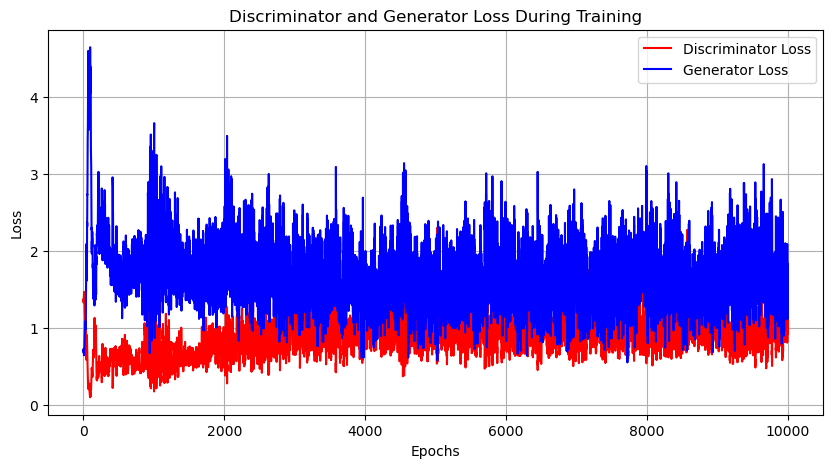

In [11]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
import matplotlib.pyplot as plt

# Assuming you have embeddings of smart contracts
real_data = torch.tensor(ill_opcode_embeddings).float().cuda()

# Updated Generator Network with best hyperparameters
class Generator(nn.Module):
    def __init__(self, input_dim, output_dim, hidden_units):
        super(Generator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(input_dim, hidden_units),
            nn.ReLU(True),
            nn.Linear(hidden_units, hidden_units * 2),
            nn.ReLU(True),
            nn.Linear(hidden_units * 2, output_dim),
            nn.Tanh()
        )

    def forward(self, x):
        return self.model(x)

# Updated Discriminator Network with best hyperparameters and dropout
class Discriminator(nn.Module):
    def __init__(self, input_dim, hidden_units, dropout_rate):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(input_dim, hidden_units * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(dropout_rate),
            nn.Linear(hidden_units * 2, hidden_units),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(dropout_rate),
            nn.Linear(hidden_units, 1),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.model(x)

# Supply the best hyperparameters
input_dim = 200  # Best input_dim found
hidden_units = 256  # Best hidden_units found
dropout_rate = 0.2  # Best dropout_rate found
batch_size = 128  # Best batch_size found
lr_g = 0.0001  # Best learning rate for generator
lr_d = 0.0005  # Best learning rate for discriminator

# Initialize the GAN with best hyperparameters
embedding_dim = real_data.shape[1]
generator = Generator(input_dim, embedding_dim, hidden_units).cuda()
discriminator = Discriminator(embedding_dim, hidden_units, dropout_rate).cuda()

# Loss and Optimizer
criterion = nn.BCELoss()
optimizer_g = optim.Adam(generator.parameters(), lr=lr_g)
optimizer_d = optim.Adam(discriminator.parameters(), lr=lr_d)

# Training Loop
num_epochs = 10000
dataloader = DataLoader(real_data, batch_size=batch_size, shuffle=True)

# Lists to store losses
d_losses = []
g_losses = []

for epoch in range(num_epochs):
    for real_samples in dataloader:
        real_samples = real_samples.cuda()
        current_batch_size = real_samples.size(0)
        
        # Train Discriminator
        optimizer_d.zero_grad()
        noise = torch.randn(current_batch_size, input_dim).cuda()
        fake_samples = generator(noise)
        real_labels = torch.ones(current_batch_size, 1).cuda()
        fake_labels = torch.zeros(current_batch_size, 1).cuda()

        real_loss = criterion(discriminator(real_samples), real_labels)
        fake_loss = criterion(discriminator(fake_samples.detach()), fake_labels)
        d_loss = real_loss + fake_loss
        d_loss.backward()
        optimizer_d.step()

        # Train Generator
        optimizer_g.zero_grad()
        g_loss = criterion(discriminator(fake_samples), real_labels)
        g_loss.backward()
        optimizer_g.step()

    # Store losses for plotting
    d_losses.append(d_loss.item())
    g_losses.append(g_loss.item())

    if epoch % 1000 == 0:
        print(f"Epoch {epoch}/{num_epochs} | D Loss: {d_loss.item()} | G Loss: {g_loss.item()}")

# Generate synthetic data
with torch.no_grad():
    synthetic_data = generator(torch.randn(1000, input_dim).cuda()).cpu().numpy()

# Plotting the loss curves
plt.figure(figsize=(10, 5))
plt.plot(d_losses, label="Discriminator Loss", color='red')
plt.plot(g_losses, label="Generator Loss", color='blue')
plt.title("Discriminator and Generator Loss During Training")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.grid(True)
plt.show()


Epoch 0/10000 | D Loss: 1.375868558883667 | G Loss: 0.6934980154037476
Epoch 1000/10000 | D Loss: 0.5347555875778198 | G Loss: 1.8699369430541992
Epoch 2000/10000 | D Loss: 0.759447455406189 | G Loss: 1.4505683183670044
Epoch 3000/10000 | D Loss: 0.9836858510971069 | G Loss: 1.162418246269226
Epoch 4000/10000 | D Loss: 0.9107490181922913 | G Loss: 1.961765170097351
Epoch 5000/10000 | D Loss: 1.3495591878890991 | G Loss: 1.3879419565200806
Epoch 6000/10000 | D Loss: 1.5666205883026123 | G Loss: 1.2980444431304932
Epoch 7000/10000 | D Loss: 1.1509084701538086 | G Loss: 1.1980952024459839
Epoch 8000/10000 | D Loss: 0.9054738283157349 | G Loss: 1.5749670267105103
Epoch 9000/10000 | D Loss: 1.5866596698760986 | G Loss: 1.8355852365493774


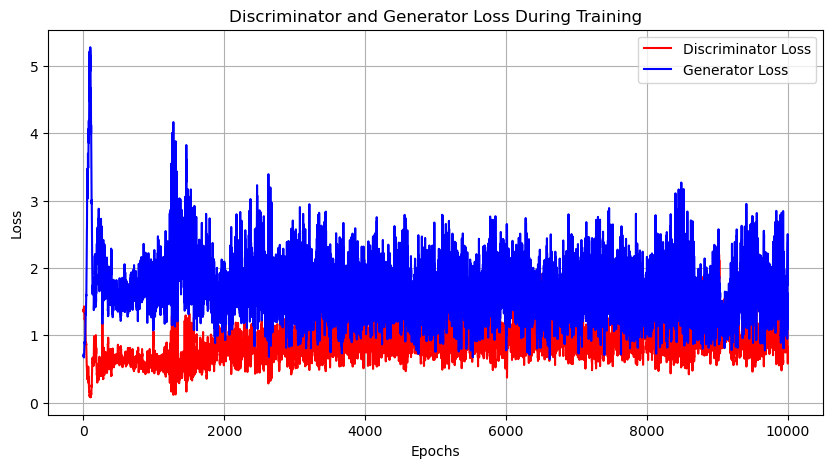

In [9]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
import matplotlib.pyplot as plt

# Assuming you have embeddings of smart contracts
real_data = torch.tensor(ill_opcode_embeddings).float().cuda()

# Updated Generator Network with best hyperparameters
class Generator(nn.Module):
    def __init__(self, input_dim, output_dim, hidden_units):
        super(Generator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(input_dim, hidden_units),
            nn.ReLU(True),
            nn.Linear(hidden_units, hidden_units * 2),
            nn.ReLU(True),
            nn.Linear(hidden_units * 2, output_dim),
            nn.Tanh()
        )

    def forward(self, x):
        return self.model(x)

# Updated Discriminator Network with best hyperparameters and dropout
class Discriminator(nn.Module):
    def __init__(self, input_dim, hidden_units, dropout_rate):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(input_dim, hidden_units * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(dropout_rate),
            nn.Linear(hidden_units * 2, hidden_units),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(dropout_rate),
            nn.Linear(hidden_units, 1),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.model(x)

# Supply the best hyperparameters
input_dim = 200  # Best input_dim found
hidden_units = 256  # Best hidden_units found
dropout_rate = 0.2  # Best dropout_rate found
batch_size = 128  # Best batch_size found
lr_g = 0.0001  # Best learning rate for generator
lr_d = 0.0005  # Best learning rate for discriminator

# Initialize the GAN with best hyperparameters
embedding_dim = real_data.shape[1]
generator = Generator(input_dim, embedding_dim, hidden_units).cuda()
discriminator = Discriminator(embedding_dim, hidden_units, dropout_rate).cuda()

# Loss and Optimizer
criterion = nn.BCELoss()
optimizer_g = optim.Adam(generator.parameters(), lr=lr_g)
optimizer_d = optim.Adam(discriminator.parameters(), lr=lr_d)

# Training Loop
num_epochs = 10000
dataloader = DataLoader(real_data, batch_size=batch_size, shuffle=True)

# Lists to store losses
d_losses = []
g_losses = []

for epoch in range(num_epochs):
    for real_samples in dataloader:
        real_samples = real_samples.cuda()
        current_batch_size = real_samples.size(0)
        
        # Train Discriminator
        optimizer_d.zero_grad()
        noise = torch.randn(current_batch_size, input_dim).cuda()
        fake_samples = generator(noise)
        real_labels = torch.ones(current_batch_size, 1).cuda()
        fake_labels = torch.zeros(current_batch_size, 1).cuda()

        real_loss = criterion(discriminator(real_samples), real_labels)
        fake_loss = criterion(discriminator(fake_samples.detach()), fake_labels)
        d_loss = real_loss + fake_loss
        d_loss.backward()
        optimizer_d.step()

        # Train Generator
        optimizer_g.zero_grad()
        g_loss = criterion(discriminator(fake_samples), real_labels)
        g_loss.backward()
        optimizer_g.step()

    # Store losses for plotting
    d_losses.append(d_loss.item())
    g_losses.append(g_loss.item())

    if epoch % 1000 == 0:
        print(f"Epoch {epoch}/{num_epochs} | D Loss: {d_loss.item()} | G Loss: {g_loss.item()}")

# Generate synthetic data
with torch.no_grad():
    synthetic_data = generator(torch.randn(1000, input_dim).cuda()).cpu().numpy()

# Plotting the loss curves
plt.figure(figsize=(10, 5))
plt.plot(d_losses, label="Discriminator Loss", color='red')
plt.plot(g_losses, label="Generator Loss", color='blue')
plt.title("Discriminator and Generator Loss During Training")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.grid(True)
plt.show()


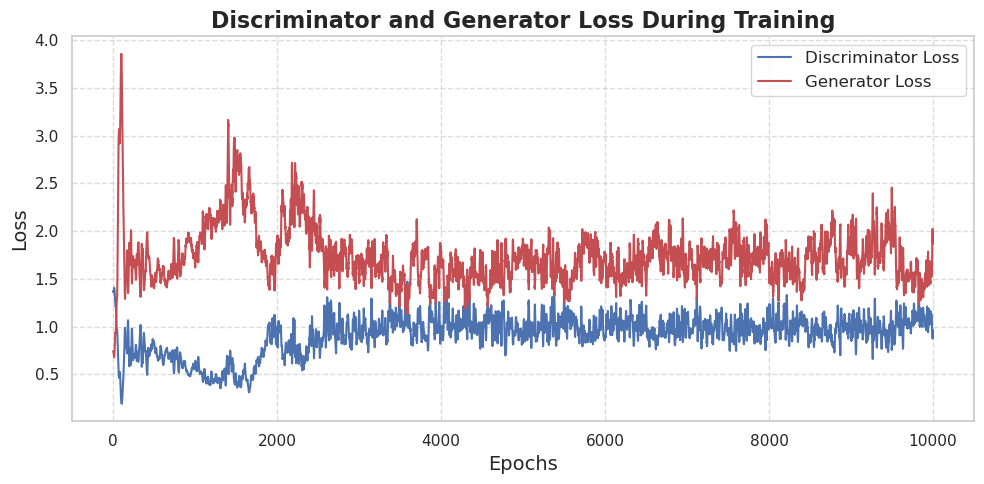

In [93]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Function to apply a simple moving average for smoothing
def smooth_curve(points, factor=0.9):
    smoothed_points = []
    for point in points:
        if smoothed_points:
            smoothed_points.append(smoothed_points[-1] * factor + point * (1 - factor))
        else:
            smoothed_points.append(point)
    return smoothed_points

# Apply smoothing to both loss curves
smoothed_d_losses = smooth_curve(d_losses, factor=0.9)
smoothed_g_losses = smooth_curve(g_losses, factor=0.9)

# Use a seaborn style for the plot
sns.set(style="whitegrid")

# Plotting the loss curves
plt.figure(figsize=(10, 5))

# Plot Discriminator Loss with transparency and smoothed curve
plt.plot(smoothed_d_losses, label="Discriminator Loss", color='#4C72B0')

# Plot Generator Loss with transparency and smoothed curve
plt.plot(smoothed_g_losses, label="Generator Loss", color='#C44E52')

# Adding titles and labels
plt.title("Discriminator and Generator Loss During Training", fontsize=16, weight='bold')
plt.xlabel("Epochs", fontsize=14)
plt.ylabel("Loss", fontsize=14)

# Adding gridlines for better readability
plt.grid(True, linestyle='--', alpha=0.7)

# Adding a legend with smaller font size
plt.legend(fontsize=12)

# Adjust layout to make everything fit well
plt.tight_layout()

# Show the plot
plt.show()


Training GAN with batch size 32
Batch Size 32 | Epoch 0/10000 | D Loss: 1.342581033706665 | G Loss: 0.7315552234649658
Batch Size 32 | Epoch 1000/10000 | D Loss: 0.8606899976730347 | G Loss: 1.8520101308822632
Batch Size 32 | Epoch 2000/10000 | D Loss: 1.3448466062545776 | G Loss: 0.9480935335159302
Batch Size 32 | Epoch 3000/10000 | D Loss: 1.3773260116577148 | G Loss: 2.121027708053589
Batch Size 32 | Epoch 4000/10000 | D Loss: 1.203720211982727 | G Loss: 1.2439539432525635
Batch Size 32 | Epoch 5000/10000 | D Loss: 1.4823987483978271 | G Loss: 1.311513900756836
Batch Size 32 | Epoch 6000/10000 | D Loss: 0.9363096952438354 | G Loss: 1.4671560525894165
Batch Size 32 | Epoch 7000/10000 | D Loss: 0.9369823932647705 | G Loss: 1.6183232069015503
Batch Size 32 | Epoch 8000/10000 | D Loss: 1.5764610767364502 | G Loss: 0.8448962569236755
Batch Size 32 | Epoch 9000/10000 | D Loss: 0.8230804800987244 | G Loss: 1.7138335704803467


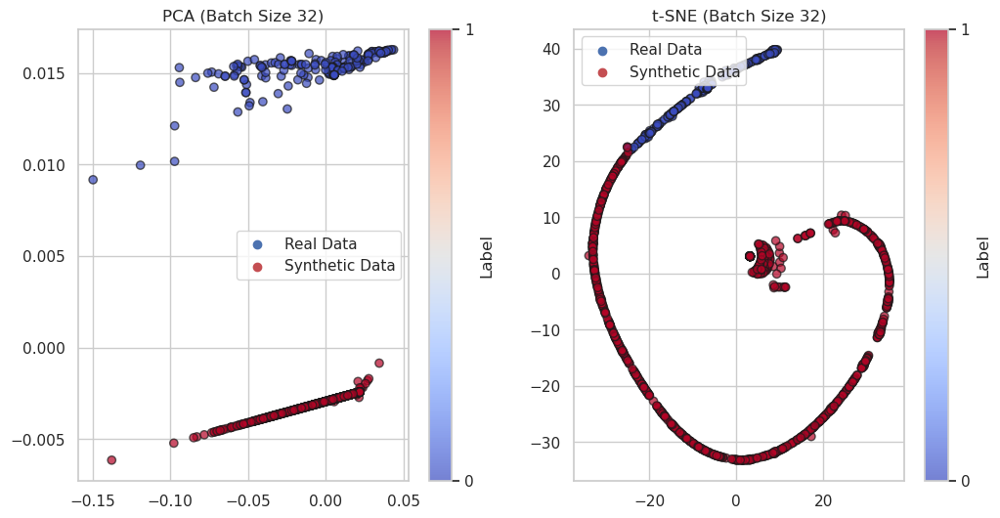

Training GAN with batch size 64
Batch Size 64 | Epoch 0/10000 | D Loss: 1.3646163940429688 | G Loss: 0.702151358127594
Batch Size 64 | Epoch 1000/10000 | D Loss: 0.8553374409675598 | G Loss: 2.126734733581543
Batch Size 64 | Epoch 2000/10000 | D Loss: 0.578978955745697 | G Loss: 2.269348382949829
Batch Size 64 | Epoch 3000/10000 | D Loss: 1.1491931676864624 | G Loss: 1.702470302581787
Batch Size 64 | Epoch 4000/10000 | D Loss: 0.8257540464401245 | G Loss: 1.267375111579895
Batch Size 64 | Epoch 5000/10000 | D Loss: 1.0452121496200562 | G Loss: 1.7143498659133911
Batch Size 64 | Epoch 6000/10000 | D Loss: 1.257902979850769 | G Loss: 1.2130917310714722
Batch Size 64 | Epoch 7000/10000 | D Loss: 1.0123735666275024 | G Loss: 1.616547703742981
Batch Size 64 | Epoch 8000/10000 | D Loss: 1.287292718887329 | G Loss: 1.0554652214050293
Batch Size 64 | Epoch 9000/10000 | D Loss: 0.8510568141937256 | G Loss: 1.9379074573516846


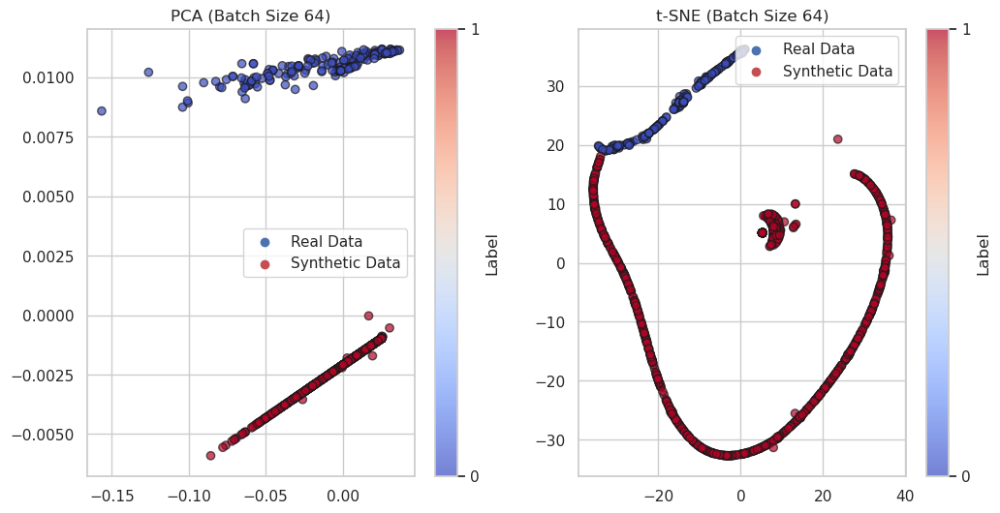

Training GAN with batch size 128
Batch Size 128 | Epoch 0/10000 | D Loss: 1.3775932788848877 | G Loss: 0.697847306728363
Batch Size 128 | Epoch 1000/10000 | D Loss: 0.7306597828865051 | G Loss: 1.6137781143188477
Batch Size 128 | Epoch 2000/10000 | D Loss: 0.5748113989830017 | G Loss: 1.9228676557540894
Batch Size 128 | Epoch 3000/10000 | D Loss: 1.0448014736175537 | G Loss: 1.9472763538360596
Batch Size 128 | Epoch 4000/10000 | D Loss: 0.8436741232872009 | G Loss: 1.9975556135177612
Batch Size 128 | Epoch 5000/10000 | D Loss: 0.9273570775985718 | G Loss: 1.683919072151184
Batch Size 128 | Epoch 6000/10000 | D Loss: 1.0873998403549194 | G Loss: 1.1008427143096924
Batch Size 128 | Epoch 7000/10000 | D Loss: 0.8264469504356384 | G Loss: 1.9414174556732178
Batch Size 128 | Epoch 8000/10000 | D Loss: 0.8976520299911499 | G Loss: 1.719298005104065
Batch Size 128 | Epoch 9000/10000 | D Loss: 1.3345246315002441 | G Loss: 1.6871201992034912


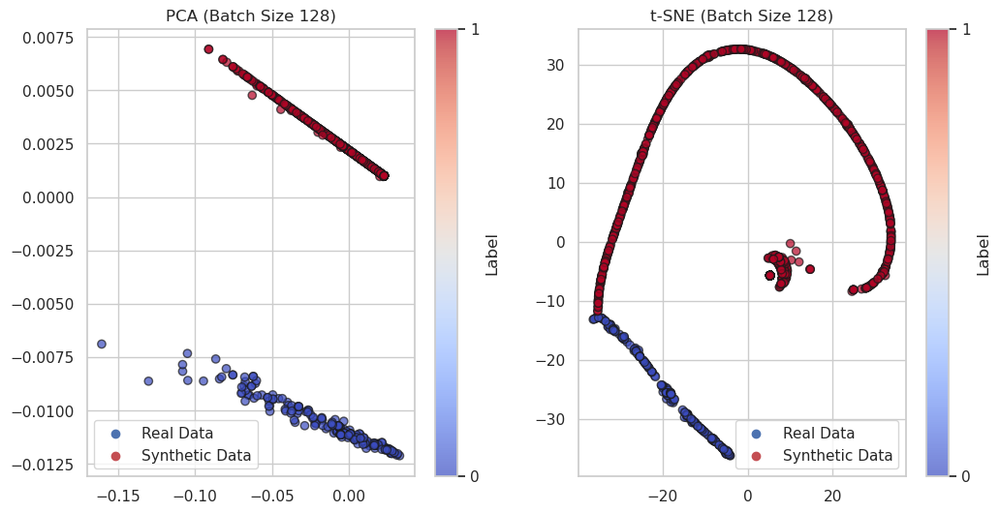

In [126]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import numpy as np

# Assuming you have embeddings of smart contracts
real_data = torch.tensor(ill_opcode_embeddings).float().cuda()

# Define Generator and Discriminator as before
class Generator(nn.Module):
    def __init__(self, input_dim, output_dim, hidden_units):
        super(Generator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(input_dim, hidden_units),
            nn.ReLU(True),
            nn.Linear(hidden_units, hidden_units * 2),
            nn.ReLU(True),
            nn.Linear(hidden_units * 2, output_dim),
            nn.Tanh()
        )

    def forward(self, x):
        return self.model(x)

class Discriminator(nn.Module):
    def __init__(self, input_dim, hidden_units, dropout_rate):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Linear(input_dim, hidden_units * 2),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(dropout_rate),
            nn.Linear(hidden_units * 2, hidden_units),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(dropout_rate),
            nn.Linear(hidden_units, 1),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.model(x)

# Define hyperparameters
input_dim = 200
hidden_units = 256
dropout_rate = 0.2
lr_g = 0.0001
lr_d = 0.0005
num_epochs = 10000
batch_sizes = [32, 64, 128]

# Function to train GAN
def train_gan(batch_size):
    generator = Generator(input_dim, real_data.shape[1], hidden_units).cuda()
    discriminator = Discriminator(real_data.shape[1], hidden_units, dropout_rate).cuda()

    criterion = nn.BCELoss()
    optimizer_g = optim.Adam(generator.parameters(), lr=lr_g)
    optimizer_d = optim.Adam(discriminator.parameters(), lr=lr_d)

    dataloader = DataLoader(real_data, batch_size=batch_size, shuffle=True)

    d_losses = []
    g_losses = []

    for epoch in range(num_epochs):
        for real_samples in dataloader:
            real_samples = real_samples.cuda()
            current_batch_size = real_samples.size(0)
            
            # Train Discriminator
            optimizer_d.zero_grad()
            noise = torch.randn(current_batch_size, input_dim).cuda()
            fake_samples = generator(noise)
            real_labels = torch.ones(current_batch_size, 1).cuda()
            fake_labels = torch.zeros(current_batch_size, 1).cuda()

            real_loss = criterion(discriminator(real_samples), real_labels)
            fake_loss = criterion(discriminator(fake_samples.detach()), fake_labels)
            d_loss = real_loss + fake_loss
            d_loss.backward()
            optimizer_d.step()

            # Train Generator
            optimizer_g.zero_grad()
            g_loss = criterion(discriminator(fake_samples), real_labels)
            g_loss.backward()
            optimizer_g.step()

        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())

        if epoch % 1000 == 0:
            print(f"Batch Size {batch_size} | Epoch {epoch}/{num_epochs} | D Loss: {d_loss.item()} | G Loss: {g_loss.item()}")

    with torch.no_grad():
        synthetic_data = generator(torch.randn(1000, input_dim).cuda()).cpu().numpy()
    
    return synthetic_data

# Generate and plot results for each batch size
for batch_size in batch_sizes:
    print(f"Training GAN with batch size {batch_size}")
    synthetic_data = train_gan(batch_size)
    
    # Combine real and synthetic data
    all_data = np.vstack([real_data.cpu().numpy(), synthetic_data])
    labels = np.array([0] * real_data.size(0) + [1] * synthetic_data.shape[0])  # 0 for real, 1 for synthetic
    
    # PCA
    pca = PCA(n_components=2)
    all_data_pca = pca.fit_transform(all_data)
    
    # t-SNE
    tsne = TSNE(n_components=2)
    all_data_tsne = tsne.fit_transform(all_data)
    
    # Plot PCA
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    scatter = plt.scatter(all_data_pca[:, 0], all_data_pca[:, 1], c=labels, cmap=plt.cm.coolwarm, alpha=0.7, edgecolor='k')
    plt.title(f'PCA (Batch Size {batch_size})')
    plt.colorbar(scatter, ticks=[0, 1], label='Label')
    plt.scatter([], [], c='#4C72B0', label='Real Data')
    plt.scatter([], [], c='#C44E52', label='Synthetic Data')
    plt.legend()

    # Plot t-SNE
    plt.subplot(1, 2, 2)
    scatter = plt.scatter(all_data_tsne[:, 0], all_data_tsne[:, 1], c=labels, cmap=plt.cm.coolwarm, alpha=0.7, edgecolor='k')
    plt.title(f't-SNE (Batch Size {batch_size})')
    plt.colorbar(scatter, ticks=[0, 1], label='Label')
    plt.scatter([], [], c='#4C72B0', label='Real Data')
    plt.scatter([], [], c='#C44E52', label='Synthetic Data')
    plt.legend()

    plt.show()

In [41]:
# Architecture Summary
def print_model_summary(model, model_name):
    print(f"Summary of {model_name}:")
    for idx, layer in enumerate(model.model):
        print(f"Layer {idx + 1}: {layer}")

print_model_summary(generator, "Generator")
print_model_summary(discriminator, "Discriminator")


Summary of Generator:
Layer 1: Linear(in_features=200, out_features=256, bias=True)
Layer 2: ReLU(inplace=True)
Layer 3: Linear(in_features=256, out_features=512, bias=True)
Layer 4: ReLU(inplace=True)
Layer 5: Linear(in_features=512, out_features=50, bias=True)
Layer 6: Tanh()
Summary of Discriminator:
Layer 1: Linear(in_features=50, out_features=512, bias=True)
Layer 2: LeakyReLU(negative_slope=0.2, inplace=True)
Layer 3: Dropout(p=0.2, inplace=False)
Layer 4: Linear(in_features=512, out_features=256, bias=True)
Layer 5: LeakyReLU(negative_slope=0.2, inplace=True)
Layer 6: Dropout(p=0.2, inplace=False)
Layer 7: Linear(in_features=256, out_features=1, bias=True)
Layer 8: Sigmoid()


/tmp/ipykernel_34110/2546233707.py:15: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(real_data_np[:, i], color='#4C72B0', shade=True, label='Real Data' if i == 0 else "")
/tmp/ipykernel_34110/2546233707.py:16: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(synthetic_data_np[:, i], color='#C44E52', shade=True, label='Synthetic Data' if i == 0 else "")
/tmp/ipykernel_34110/2546233707.py:15: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(real_data_np[:, i], color='#4C72B0', shade=True, label='Real Data' if i == 0 else "")
/tmp/ipykernel_34110/2546233707.py:16: FutureWarning: 

`shade` is now deprecated in favor of `fill`; set

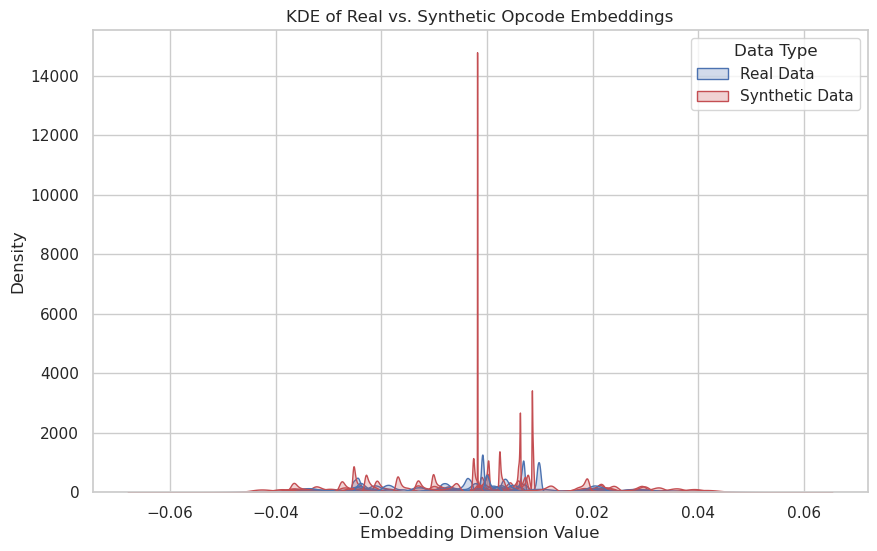

In [45]:
import seaborn as sns
from sklearn.manifold import TSNE

# Assuming 'synthetic_data' is the generated data and 'real_data' is the real data
synthetic_data_np = synthetic_data
real_data_np = real_data.cpu().numpy()

# Combine the data for t-SNE visualization
combined_data = np.vstack((real_data_np, synthetic_data_np))
labels = np.array([0] * real_data_np.shape[0] + [1] * synthetic_data_np.shape[0])

# Compare distributions of real and synthetic data using histograms or KDE
plt.figure(figsize=(10, 6))
for i in range(embedding_dim):
    sns.kdeplot(real_data_np[:, i], color='#4C72B0', shade=True, label='Real Data' if i == 0 else "")
    sns.kdeplot(synthetic_data_np[:, i], color='#C44E52', shade=True, label='Synthetic Data' if i == 0 else "")
plt.title('KDE of Real vs. Synthetic Opcode Embeddings')
plt.xlabel('Embedding Dimension Value')
plt.ylabel('Density')
plt.legend(title='Data Type', loc='best')
plt.show()

In [10]:
# After generating synthetic_data

# Compute FID Score
import numpy as np
from scipy.linalg import sqrtm

# Convert embeddings to NumPy arrays if they aren't already
real_embeddings = ill_opcode_embeddings  # Shape: (num_real_samples, embedding_dim)
synthetic_embeddings = synthetic_data    # Shape: (num_synthetic_samples, embedding_dim)

# Ensure both embeddings have the same dimension
assert real_embeddings.shape[1] == synthetic_embeddings.shape[1], "Embedding dimensions do not match."

# Calculate FID
mu_real = np.mean(real_embeddings, axis=0)
sigma_real = np.cov(real_embeddings, rowvar=False)

mu_synthetic = np.mean(synthetic_embeddings, axis=0)
sigma_synthetic = np.cov(synthetic_embeddings, rowvar=False)

# Calculate squared difference between means
mean_diff = mu_real - mu_synthetic
mean_norm = mean_diff.dot(mean_diff)

# Compute sqrt of product of covariances
covmean, _ = sqrtm(sigma_real.dot(sigma_synthetic), disp=False)

# Handle imaginary numbers from sqrtm
if np.iscomplexobj(covmean):
    covmean = covmean.real

# Calculate FID score
fid_score = mean_norm + np.trace(sigma_real + sigma_synthetic - 2 * covmean)
print(f"FID Score: {fid_score:.4f}")


FID Score: 0.0003


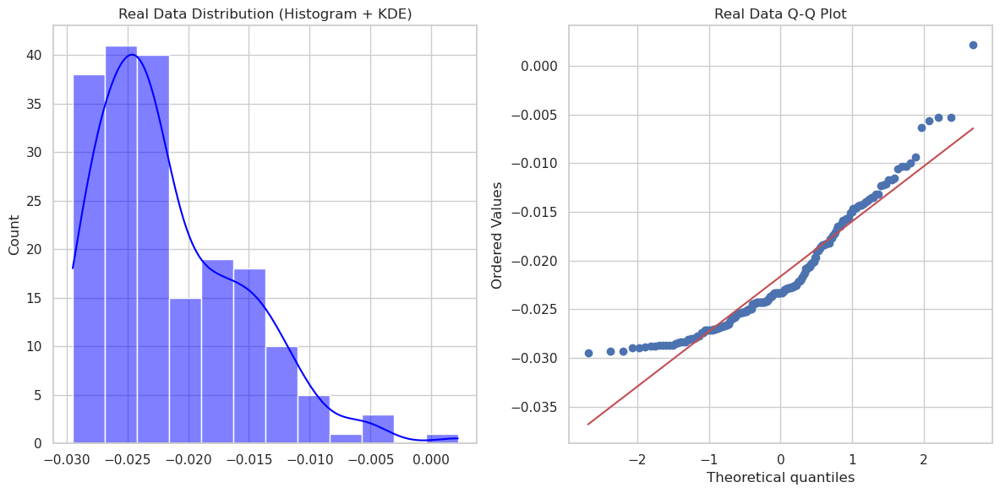

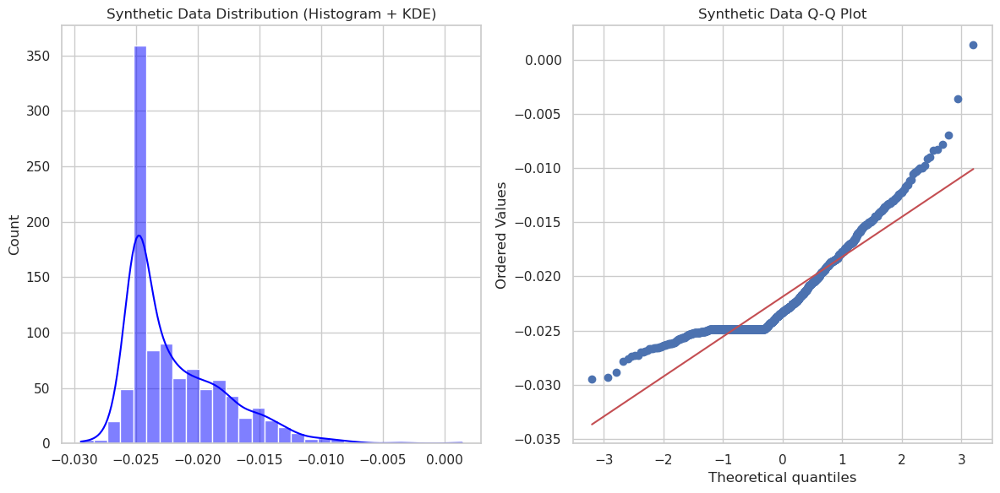

Real Data Shapiro-Wilk Test: Stat=0.917, p=0.000
Synthetic Data Shapiro-Wilk Test: Stat=0.860, p=0.000
Real data does not look normally distributed (reject H0)
Synthetic data does not look normally distributed (reject H0)
Mann-Whitney U test result: Stat=91005.000, p=0.299


In [49]:
import numpy as np
from scipy import stats
import seaborn as sns
import matplotlib.pyplot as plt

# Assume real_embeddings and synthetic_data are your real and synthetic embeddings

# Step 1: Check for normality using histograms, KDE, and Q-Q plots
def check_normality(data, label):
    plt.figure(figsize=(12, 6))

    # Histogram and KDE plot
    plt.subplot(1, 2, 1)
    sns.histplot(data, kde=True, color='blue', label=f'{label} Data')
    plt.title(f'{label} Data Distribution (Histogram + KDE)')
    
    # Q-Q plot
    plt.subplot(1, 2, 2)
    stats.probplot(data, dist="norm", plot=plt)
    plt.title(f'{label} Data Q-Q Plot')

    plt.tight_layout()
    plt.show()

# Check normality for real and synthetic embeddings for the first feature
check_normality(real_embeddings[:, 0], "Real")
check_normality(synthetic_data[:, 0], "Synthetic")

# Step 2: Shapiro-Wilk Test for normality
real_stat, real_p = stats.shapiro(real_embeddings[:, 0])
synthetic_stat, synthetic_p = stats.shapiro(synthetic_data[:, 0])

print(f'Real Data Shapiro-Wilk Test: Stat={real_stat:.3f}, p={real_p:.3f}')
print(f'Synthetic Data Shapiro-Wilk Test: Stat={synthetic_stat:.3f}, p={synthetic_p:.3f}')

# Interpretation of the Shapiro-Wilk test
alpha = 0.05
if real_p > alpha:
    print('Real data looks normally distributed (fail to reject H0)')
else:
    print('Real data does not look normally distributed (reject H0)')

if synthetic_p > alpha:
    print('Synthetic data looks normally distributed (fail to reject H0)')
else:
    print('Synthetic data does not look normally distributed (reject H0)')

#  Perform a t-test or Mann-Whitney U test based on normality
if real_p > alpha and synthetic_p > alpha:
    # Use t-test if both distributions are normal
    t_stat, t_p = stats.ttest_ind(real_embeddings[:, 0], synthetic_data[:, 0])
    print(f'T-test result: Stat={t_stat:.3f}, p={t_p:.3f}')
else:
    # Use Mann-Whitney U test if normality is violated
    u_stat, u_p = stats.mannwhitneyu(real_embeddings[:, 0], synthetic_data[:, 0])
    print(f'Mann-Whitney U test result: Stat={u_stat:.3f}, p={u_p:.3f}')


In [56]:
import numpy as np
import pandas as pd

# Ensure the same number of samples by downsampling the larger dataset
min_samples = min(real_data.shape[0], synthetic_data.shape[0])

# Randomly sample from the synthetic data to match the number of real data samples
synthetic_sampled = np.random.choice(synthetic_data.shape[0], min_samples, replace=False)
best_synthetic_data_sampled = synthetic_data[synthetic_sampled]

# Now the shapes of the arrays should match
mean_real = real_data.cpu().numpy().mean(axis=0)
mean_synthetic = best_synthetic_data_sampled.mean(axis=0)
mean_diff = np.abs(mean_real - mean_synthetic).mean()

var_real = real_data.cpu().numpy().var(axis=0)
var_synthetic = best_synthetic_data_sampled.var(axis=0)
var_ratio = (var_synthetic / var_real).mean()

# Flatten arrays to calculate correlation coefficient
real_flattened = real_data.cpu().numpy()[:min_samples].flatten()
synthetic_flattened = best_synthetic_data_sampled.flatten()
corr_coeff = np.corrcoef(real_flattened, synthetic_flattened)[0, 1]

# Summarize in a table
summary_df = pd.DataFrame({
    'Metric': ['Mean Absolute Difference', 'Variance Ratio', 'Correlation Coefficient'],
    'Value': [mean_diff, var_ratio, corr_coeff]
})

summary_df

,Metric,Value
0,Mean Absolute Difference,0.002272
1,Variance Ratio,0.465495
2,Correlation Coefficient,0.946304


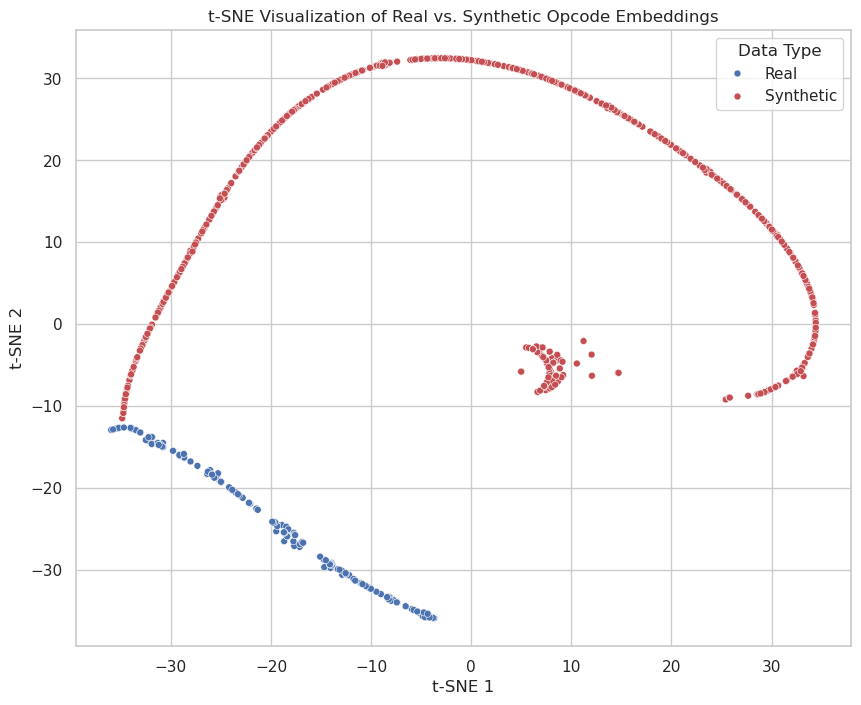

In [127]:
import seaborn as sns
from sklearn.manifold import TSNE
# Combine real and synthetic data for t-SNE visualization
combined_data = np.vstack((real_data.cpu().numpy(), synthetic_data))
labels = np.array(['Real'] * real_data.size(0) + ['Synthetic'] * synthetic_data.shape[0])

# Apply t-SNE
tsne = TSNE(n_components=2, random_state=42)
tsne_results = tsne.fit_transform(combined_data)

# Create a DataFrame for plotting
tsne_df = pd.DataFrame(tsne_results, columns=['t-SNE 1', 't-SNE 2'])
tsne_df['Data Type'] = labels

# Plotting
plt.figure(figsize=(10, 8))
sns.scatterplot(x='t-SNE 1', y='t-SNE 2', hue='Data Type', palette={'Real': '#4C72B0', 'Synthetic': '#C44E52'}, data=tsne_df, s=25)
plt.title('t-SNE Visualization of Real vs. Synthetic Opcode Embeddings')
plt.show()


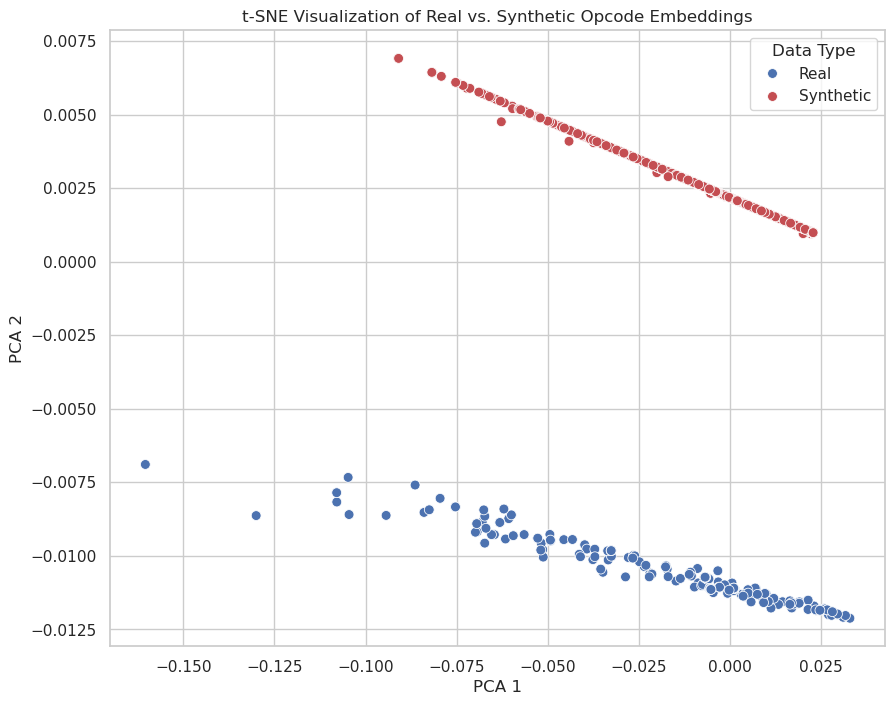

In [133]:
import seaborn as sns
from sklearn.manifold import TSNE
# Combine real and synthetic data for t-SNE visualization
combined_data = np.vstack((real_data.cpu().numpy(), synthetic_data))
labels = np.array(['Real'] * real_data.size(0) + ['Synthetic'] * synthetic_data.shape[0])

# Apply t-SNE
tsne = PCA(n_components=2)
tsne_results = tsne.fit_transform(combined_data)

# Create a DataFrame for plotting
tsne_df = pd.DataFrame(tsne_results, columns=['PCA 1', 'PCA 2'])
tsne_df['Data Type'] = labels

# Plotting
plt.figure(figsize=(10, 8))
sns.scatterplot(x='PCA 1', y='PCA 2', hue='Data Type', palette={'Real': '#4C72B0', 'Synthetic': '#C44E52'}, data=tsne_df, s=50)
plt.title('t-SNE Visualization of Real vs. Synthetic Opcode Embeddings')
plt.show()


In [111]:
y.value_counts()

is_reputable
1    3085
0     191
Name: count, dtype: int64

# Models w Augmented Data

In [12]:
# Create labels for synthetic data
synthetic_labels = np.zeros(len(synthetic_data))  # these are illicit contracts (label 0)

In [13]:
print("Shape of X:", X.shape)
print("Shape of synthetic_data:", synthetic_data.shape)


Shape of X: (3276, 50)
Shape of synthetic_data: (1000, 50)


In [65]:
# Concatenate original and synthetic data
X_combined_old = np.vstack((X, synthetic_data))
y_combined_old = np.hstack((y, synthetic_labels))

## extra mini dataset

In [15]:
# Load and preprocess the dataset
df_tmp = pd.read_csv("PonziDataset_20221114.csv")
df_tmp = df_tmp[['address', 'contractCode', 'label']]
df_tmp['opcode'] = df_tmp['contractCode'].apply(bytecode_to_opcode)
df_tmp['opcode'] = df_tmp['opcode'].apply(simplify_opcode)
df_tmp['label'].value_counts()

label
0    6184
1     314
Name: count, dtype: int64

In [16]:
# Prepare X_tmp and y_tmp
X_tmp = df_tmp['opcode']
y_tmp = 1 - df_tmp['label']

# Tokenize the opcode sequences
tokenizer_tmp = Tokenizer()
tokenizer_tmp.fit_on_texts(X_tmp)
sequences_tmp = tokenizer_tmp.texts_to_sequences(X_tmp)

# Get the vocabulary size
vocab_size_tmp = len(tokenizer_tmp.word_index) + 1

# Pad sequences to the same length
max_length_tmp = max(len(seq) for seq in sequences_tmp)
sequences_padded_tmp = pad_sequences(sequences_tmp, maxlen=max_length_tmp, padding='post')

# Define the Word2Vec model using the Embedding layer
embedding_dim_tmp = 50  # Size of the embedding vector
embedding_model_tmp = tf.keras.Sequential([
    Embedding(input_dim=vocab_size_tmp, output_dim=embedding_dim_tmp, input_length=max_length_tmp),
])

# Compile the model (no actual training is required for this task)
embedding_model_tmp.compile('rmsprop', 'mse')

# Define batch processing parameters
batch_size_tmp = 50  # Adjusted based on GPU memory capacity
num_batches_tmp = int(np.ceil(len(sequences_padded_tmp) / batch_size_tmp))

# List to store embeddings
opcode_embeddings_tmp = []

# Process each batch
for i in range(num_batches_tmp):
    start_idx_tmp = i * batch_size_tmp
    end_idx_tmp = min((i + 1) * batch_size_tmp, len(sequences_padded_tmp))
    
    # Get the batch of padded sequences
    batch_sequences_padded_tmp = sequences_padded_tmp[start_idx_tmp:end_idx_tmp]
    
    # Generate embeddings for the current batch
    batch_embeddings_tmp = embedding_model_tmp.predict(batch_sequences_padded_tmp)
    
    # Compute the mean embedding for each sequence
    batch_mean_embeddings_tmp = np.mean(batch_embeddings_tmp, axis=1)
    
    # Store the result
    opcode_embeddings_tmp.append(batch_mean_embeddings_tmp)

# Concatenate all batch embeddings
opcode_embeddings_tmp = np.vstack(opcode_embeddings_tmp)

# Apply the mask to select the corresponding embeddings and labels
X_tmp = opcode_embeddings_tmp

/home/malikcyrus/anaconda3/envs/code-env/lib/python3.12/site-packages/keras/src/layers/core/embedding.py:90: UserWarning: Argument `input_length` is deprecated. Just remove it.
  warnings.warn(


1/2 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/stepWARNING:tensorflow:5 out of the last 138 calls to <function TensorFlowTrainer.make_predict_function.<locals>.one_step_on_data_distributed at 0x7fc9b21b3a60> triggered tf.function retracing. Tracing is expensive and the excessive number of tracings could be due to (1) creating @tf.function repeatedly in a loop, (2) passing tensors with different shapes, (3) passing Python objects instead of tensors. For (1), please define your @tf.function outside of the loop. For (2), @tf.function has reduce_retracing=True option that can avoid unnecessary retracing. For (3), please refer to https://www.tensorflow.org/guide/function#controlling_retracing and https://www.tensorflow.org/api_docs/python/tf/function for  more details.
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step


In [17]:
# Add the filtered data to the existing combined data
X_combined = np.vstack((X_combined_old, X_tmp))
y_combined = np.hstack((y_combined_old, y_tmp))


In [67]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

# Separate original data into majority (is_reputable = 1) and minority (is_reputable = 0)
X_majority = X_combined_old[y_combined_old == 1]
y_majority = y_combined_old[y_combined_old == 1]
X_minority = X_combined_old[y_combined_old == 0]
y_minority = y_combined_old[y_combined_old == 0]

# Concatenate synthetic data with the minority class
X_minority_combined = np.vstack((X_minority, synthetic_data))
y_minority_combined = np.hstack((y_minority, synthetic_labels))

# Shuffle the combined minority dataset
X_minority_combined, y_minority_combined = shuffle(X_minority_combined, y_minority_combined, random_state=42)

# Split the majority class data into training and testing setsa
# Define the training percentage for the majority class (e.g., 70% for training)
train_percentage_majority = 0.7

X_majority_train, X_majority_test, y_majority_train, y_majority_test = train_test_split(
    X_majority, y_majority, test_size=(1 - train_percentage_majority), random_state=42
)

# Combine the minority class (with synthetic data) with the majority class training data
X_train = np.vstack((X_minority_combined, X_majority_train))
y_train = np.hstack((y_minority_combined, y_majority_train))

# For testing, use the original majority class test data and the real minority class data
X_test = np.vstack((X_minority, X_majority_test))
y_test = np.hstack((y_minority, y_majority_test))

# Shuffle the final training and testing sets
X_train, y_train = shuffle(X_train, y_train, random_state=42)
X_test, y_test = shuffle(X_test, y_test, random_state=42)

# At this point, X_train and y_train contain the training data with the synthetic minority class
# and a percentage of the majority class. X_test and y_test contain only real test data.


## LightGBM

Starting stratified Cross-validation using LGBM
[LightGBM] [Info] Number of positive: 7415, number of negative: 1204
[LightGBM] [Info] Number of positive: 7415, number of negative: 1204
[LightGBM] [Info] Number of positive: 7415, number of negative: 1204
[LightGBM] [Info] Number of positive: 7415, number of negative: 1204
[LightGBM] [Info] Number of positive: 7416, number of negative: 1204
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.010307 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12750
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.014690 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12750
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001626 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col

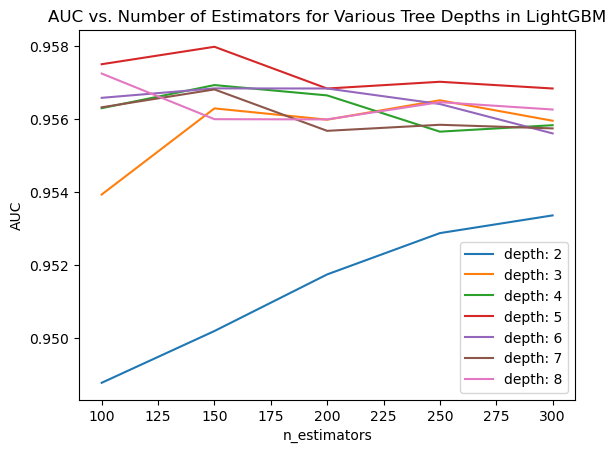

In [68]:
from sklearn.model_selection import StratifiedKFold, GridSearchCV
def stratified_k_fold_LGBM(X, Y, n_folds):
    # import matplotlib
    # matplotlib.use('Agg')
    print("Starting stratified Cross-validation using LGBM")
    clf = lgb.LGBMClassifier(learning_rate=0.2)
    max_depth = [2, 3, 4, 5, 6, 7, 8]
    n_estimators = [100, 150, 200, 250, 300]
    param_grid = dict(max_depth=max_depth, n_estimators=n_estimators)

    kfold = StratifiedKFold(n_splits=n_folds, shuffle=True, random_state=7)
    score = {'f1', 'roc_auc', 'accuracy'}
    current = time.time()
    #results = cross_validate(model1, X, Y, cv=kfold, scoring=scoring, return_train_score=True, n_jobs=-1)
    results = GridSearchCV(clf,param_grid, cv=kfold, scoring='roc_auc', n_jobs=6)
    grid_result = results.fit(X, Y)

    # summarize results
    print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
    means = grid_result.cv_results_['mean_test_score']
    stds = grid_result.cv_results_['std_test_score']
    params = grid_result.cv_results_['params']

    for mean, stdev, param in zip(means, stds, params):
        print("%f (%f) with: %r" % (mean, stdev, param))
    print("Execution time: ", time.time() - current)

    # plot results
    scores = np.array(means).reshape(len(max_depth), len(n_estimators))
    for i, value in enumerate(max_depth):
        plt.plot(n_estimators, scores[i], label='depth: ' + str(value))
    plt.legend()
    plt.xlabel('n_estimators')
    plt.ylabel('AUC')
    plt.title("AUC vs. Number of Estimators for Various Tree Depths in LightGBM")
    plt.grid(False)
    plt.show()
    return grid_result.best_params_

best_lgbm_params = stratified_k_fold_LGBM(X_combined, y_combined, 5)

In [69]:
best_lgbm_params

{'max_depth': 5, 'n_estimators': 150}

[LightGBM] [Info] Number of positive: 2498, number of negative: 2200
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000786 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12750
[LightGBM] [Info] Number of data points in the train set: 4698, number of used features: 50
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.531716 -> initscore=0.127033
[LightGBM] [Info] Start training from score 0.127033
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

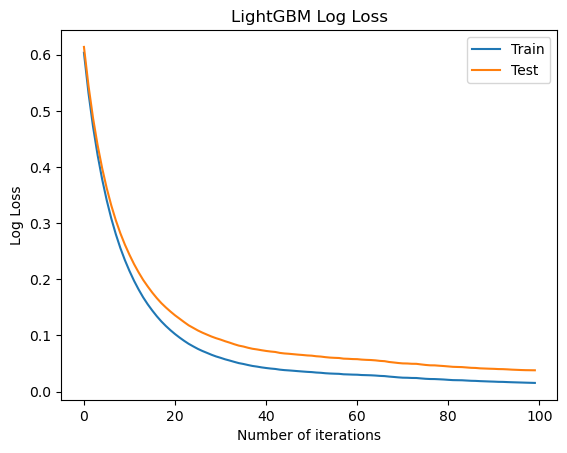

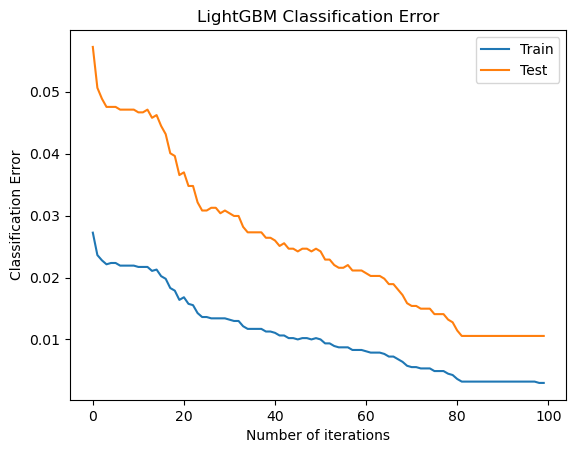

In [70]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import (
    precision_recall_fscore_support,
    roc_auc_score,
    precision_recall_curve,
    auc,
    roc_curve, 
    accuracy_score, 
    classification_report
)
import lightgbm as lgb
import xgboost as xgb
from sklearn.ensemble import AdaBoostClassifier

# Function to train and evaluate the model with log loss plotting
def train_and_evaluate_LGBM(X_train, y_train, X_test, y_test):
    clf = lgb.LGBMClassifier(learning_rate=0.1,
                             max_depth=8,
                             subsample=0.5,
                             reg_alpha=0.1, 
                             reg_lambda=0.01,
                             objective='binary',
                             n_estimators=100)
    
    eval_set = [(X_train, y_train), (X_test, y_test)]
    clf.fit(X_train, y_train, eval_metric=["binary_error", "binary_logloss"],
            eval_set=eval_set)

    # Predict
    y_pred = clf.predict(X_test)
    predicted_values = [round(val) for val in y_pred]

    # Evaluation
    accuracy = accuracy_score(y_test, predicted_values)
    print("Accuracy: %.2f%%" % (accuracy * 100.0))
    print(classification_report(y_test, y_pred, digits=4))

    # Performance metrics 
    results = clf.evals_result_
    epochs = len(results['training']['binary_error'])
    x_axis = range(0, epochs)

    # Plotting log loss
    fig, ax = plt.subplots()
    ax.plot(x_axis, results['training']['binary_logloss'], label='Train')
    ax.plot(x_axis, results['valid_1']['binary_logloss'], label='Test')
    ax.legend()
    plt.ylabel('Log Loss')
    plt.xlabel('Number of iterations')
    plt.title('LightGBM Log Loss')
    plt.grid(False)
    plt.show()

    # Plot classification error
    fig, ax = plt.subplots()
    ax.plot(x_axis, results['training']['binary_error'], label='Train')
    ax.plot(x_axis, results['valid_1']['binary_error'], label='Test')
    ax.legend()
    plt.ylabel('Classification Error')
    plt.xlabel('Number of iterations')
    plt.title('LightGBM Classification Error')
    plt.grid(False)
    plt.show()

    return clf

# Perform stratified K-Fold cross-validation and tuning
best_lgbm = train_and_evaluate_LGBM(X_train, y_train, X_test, y_test)

In [2]:
import pandas as pd 
df = pd.read_csv("/home/malikcyrus/crypto-multimodal-reputability/code_analysis/sol_contracts/Ponzi_label.csv")
df['Ponzi'].value_counts()

Ponzi
0        3590
1         200
error       3
Name: count, dtype: int64

In [71]:
df1 = pd.read_csv("/home/malikcyrus/crypto-multimodal-reputability/code_analysis/sol_contracts/benchmark_bytecode.csv")
df1['label'] = 0
df2 = pd.read_csv("/home/malikcyrus/crypto-multimodal-reputability/code_analysis/sol_contracts/benchmark_bytecode_normal.csv")
df2['label'] = 1
df = pd.concat([df1, df2], ignore_index=True)
# df = df1

In [61]:
df['opcode'] = df['byte_code'].apply(bytecode_to_opcode)
df['opcode'] = df['opcode'].apply(simplify_opcode)
X = df['opcode']
y = df['label']

In [55]:
df['label'].value_counts()

label
0    200
Name: count, dtype: int64

In [62]:
# Assuming X contains your opcode sequences
opcode_sequences = X

# Tokenize the sequences
tokenizer = Tokenizer()
tokenizer.fit_on_texts(opcode_sequences)
sequences = tokenizer.texts_to_sequences(opcode_sequences)

# Get the vocabulary size
vocab_size = len(tokenizer.word_index) + 1

# Pad sequences to the same length
max_length = max(len(seq) for seq in sequences)
sequences_padded = pad_sequences(sequences, maxlen=max_length, padding='post')

# Define the Word2Vec model using the Embedding layer
embedding_dim = 50  # Size of the embedding vector
embedding_model = tf.keras.Sequential([
    Embedding(input_dim=vocab_size, output_dim=embedding_dim, input_length=max_length),
])

# Compile the model (no actual training is required for this task)
embedding_model.compile('rmsprop', 'mse')

# Define batch processing parameters
batch_size = 50  # Adjusted based on GPU memory capacity
num_batches = int(np.ceil(len(sequences_padded) / batch_size))

# List to store embeddings
opcode_embeddings = []

# Process each batch
for i in range(num_batches):
    start_idx = i * batch_size
    end_idx = min((i + 1) * batch_size, len(sequences_padded))
    
    # Get the batch of padded sequences
    batch_sequences_padded = sequences_padded[start_idx:end_idx]
    
    # Generate embeddings for the current batch
    batch_embeddings = embedding_model.predict(batch_sequences_padded)
    
    # Compute the mean embedding for each sequence
    batch_mean_embeddings = np.mean(batch_embeddings, axis=1)
    
    # Store the result
    opcode_embeddings.append(batch_mean_embeddings)

# Concatenate all batch embeddings
opcode_embeddings = np.vstack(opcode_embeddings)

X = opcode_embeddings

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step 


/home/malikcyrus/anaconda3/envs/code-env/lib/python3.12/site-packages/keras/src/layers/core/embedding.py:90: UserWarning: Argument `input_length` is deprecated. Just remove it.
  warnings.warn(


2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
2/2 ━━━━━━━━

In [32]:
y = 1 - y

Accuracy: 0.9936322631997877
Precision: 0.9935822742030198
Recall: 0.9936322631997877
F1 Score: 0.9936018860932037


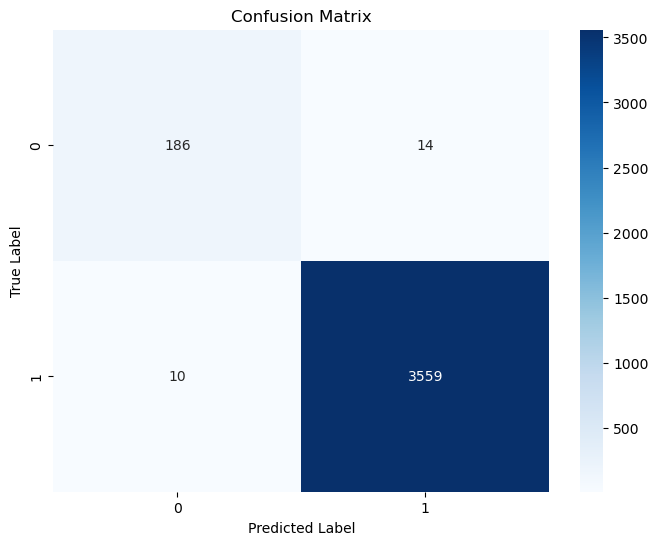

Classification Report:
               precision    recall  f1-score   support

           0     0.9490    0.9300    0.9394       200
           1     0.9961    0.9972    0.9966      3569

    accuracy                         0.9936      3769
   macro avg     0.9725    0.9636    0.9680      3769
weighted avg     0.9936    0.9936    0.9936      3769



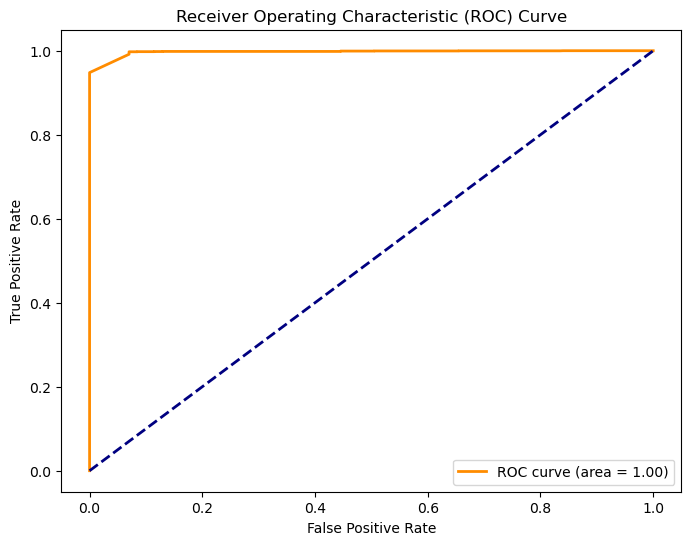

In [72]:
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, roc_auc_score, confusion_matrix, classification_report, roc_curve, auc
import matplotlib.pyplot as plt
import seaborn as sns

# Perform predictions
predictions = best_lgbm.predict(X)

# Accuracy
accuracy = accuracy_score(y, predictions)
print("Accuracy:", accuracy)

# Precision, Recall, F1-Score
precision = precision_score(y, predictions, average='weighted')  # 'binary' if binary classification
recall = recall_score(y, predictions, average='weighted')
f1 = f1_score(y, predictions, average='weighted')
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)

# ROC-AUC Score (applicable for binary classification or multi-class with 'ovr' option)
# if len(set(y)) == 2:  # Binary classification
#     roc_auc = roc_auc_score(y, predictions)
#     print("ROC-AUC:", roc_auc)
# else:  # Multi-class ROC-AUC with one-vs-rest approach
#     roc_auc = roc_auc_score(y, best_lgbm.predict_proba(X), multi_class="ovr")
#     print("ROC-AUC (OvR):", roc_auc)

# Confusion Matrix
conf_matrix = confusion_matrix(y, predictions)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=True, yticklabels=True)
plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()

# Classification Report
class_report = classification_report(y, predictions, digits=4)
print("Classification Report:\n", class_report)

# ROC Curve (only for binary classification)
if len(set(y)) == 2:
    fpr, tpr, thresholds = roc_curve(y, best_lgbm.predict_proba(X)[:, 1])
    roc_auc = auc(fpr, tpr)
    
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f"ROC curve (area = {roc_auc:.2f})")
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title("Receiver Operating Characteristic (ROC) Curve")
    plt.legend(loc="lower right")
    plt.show()


Starting stratified Cross-validation using XGBoost


/home/malikcyrus/anaconda3/envs/code-env/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [19:10:16] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/malikcyrus/anaconda3/envs/code-env/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [19:10:16] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/malikcyrus/anaconda3/envs/code-env/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [19:10:16] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/malikcyrus/anaconda3/envs/code-env/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [19:10:16] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/home/malikcyrus/anaconda3/envs/

Best: 0.961437 using {'max_depth': 8, 'n_estimators': 200}
0.958190 (0.002375) with: {'max_depth': 2, 'n_estimators': 100}
0.958920 (0.003849) with: {'max_depth': 2, 'n_estimators': 150}
0.959549 (0.004704) with: {'max_depth': 2, 'n_estimators': 200}
0.959802 (0.005181) with: {'max_depth': 2, 'n_estimators': 250}
0.959926 (0.005151) with: {'max_depth': 2, 'n_estimators': 300}
0.959078 (0.004328) with: {'max_depth': 3, 'n_estimators': 100}
0.960303 (0.004688) with: {'max_depth': 3, 'n_estimators': 150}
0.960373 (0.004396) with: {'max_depth': 3, 'n_estimators': 200}
0.959771 (0.005007) with: {'max_depth': 3, 'n_estimators': 250}
0.960095 (0.004579) with: {'max_depth': 3, 'n_estimators': 300}
0.959611 (0.005986) with: {'max_depth': 4, 'n_estimators': 100}
0.960638 (0.006307) with: {'max_depth': 4, 'n_estimators': 150}
0.960744 (0.006527) with: {'max_depth': 4, 'n_estimators': 200}
0.961130 (0.006635) with: {'max_depth': 4, 'n_estimators': 250}
0.961039 (0.006649) with: {'max_depth': 4, 'n

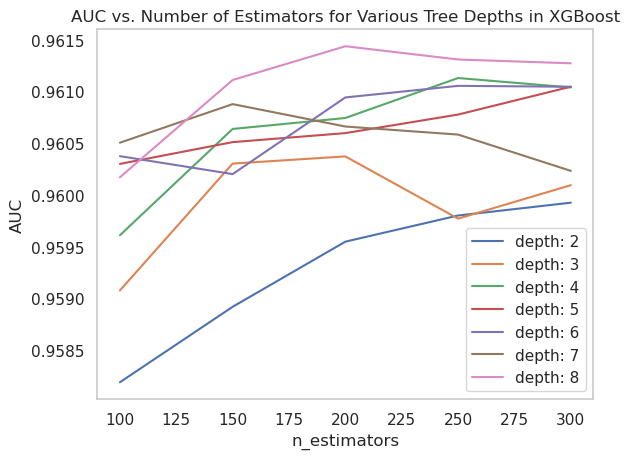

In [95]:
from xgboost import XGBClassifier
from sklearn.model_selection import StratifiedKFold, GridSearchCV
import matplotlib.pyplot as plt
import numpy as np
import time

def stratified_k_fold_XGBoost(X, Y, n_folds):
    print("Starting stratified Cross-validation using XGBoost")
    
    # Define the model
    clf = XGBClassifier(learning_rate=0.2, use_label_encoder=False, eval_metric='logloss')

    # Define the parameter grid
    max_depth = [2, 3, 4, 5, 6, 7, 8]
    n_estimators = [100, 150, 200, 250, 300]
    param_grid = dict(max_depth=max_depth, n_estimators=n_estimators)

    # Stratified k-fold cross-validation setup
    kfold = StratifiedKFold(n_splits=n_folds, shuffle=True, random_state=7)

    # Define scoring metrics
    score = {'f1', 'roc_auc', 'accuracy'}

    # Start timing the process
    current = time.time()

    # Use GridSearchCV to tune the hyperparameters
    results = GridSearchCV(clf, param_grid, cv=kfold, scoring='roc_auc', n_jobs=-1)

    # Fit the model and find the best parameters
    grid_result = results.fit(X, Y)

    # Summarize results
    print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
    means = grid_result.cv_results_['mean_test_score']
    stds = grid_result.cv_results_['std_test_score']
    params = grid_result.cv_results_['params']

    for mean, stdev, param in zip(means, stds, params):
        print("%f (%f) with: %r" % (mean, stdev, param))
    
    print("Execution time: ", time.time() - current)

    # Plot the results
    scores = np.array(means).reshape(len(max_depth), len(n_estimators))
    for i, value in enumerate(max_depth):
        plt.plot(n_estimators, scores[i], label='depth: ' + str(value))
    
    plt.legend()
    plt.xlabel('n_estimators')
    plt.ylabel('AUC')
    plt.title("AUC vs. Number of Estimators for Various Tree Depths in XGBoost")
    plt.grid(False)
    plt.show()

    return grid_result.best_params_

# Example usage of the function:
best_xgb_params = stratified_k_fold_XGBoost(X_combined, y_combined, 5)

[0]	validation_0-logloss:0.50005	validation_0-error:0.35552	validation_1-logloss:0.47722	validation_1-error:0.17099
[1]	validation_0-logloss:0.40579	validation_0-error:0.04866	validation_1-logloss:0.43190	validation_1-error:0.15040
[2]	validation_0-logloss:0.33823	validation_0-error:0.04418	validation_1-logloss:0.39555	validation_1-error:0.13339
[3]	validation_0-logloss:0.28964	validation_0-error:0.04209	validation_1-logloss:0.37079	validation_1-error:0.12892
[4]	validation_0-logloss:0.25000	validation_0-error:0.04060	validation_1-logloss:0.34592	validation_1-error:0.12444
[5]	validation_0-logloss:0.22039	validation_0-error:0.03940	validation_1-logloss:0.32798	validation_1-error:0.11728
[6]	validation_0-logloss:0.19880	validation_0-error:0.03761	validation_1-logloss:0.31715	validation_1-error:0.11459
[7]	validation_0-logloss:0.17955	validation_0-error:0.03821	validation_1-logloss:0.30541	validation_1-error:0.11817
[8]	validation_0-logloss:0.16251	validation_0-error:0.03701	validation_1

/home/malikcyrus/anaconda3/envs/code-env/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [19:16:03] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[13]	validation_0-logloss:0.11615	validation_0-error:0.03254	validation_1-logloss:0.25713	validation_1-error:0.10474
[14]	validation_0-logloss:0.10929	validation_0-error:0.03134	validation_1-logloss:0.24712	validation_1-error:0.10116
[15]	validation_0-logloss:0.10545	validation_0-error:0.03045	validation_1-logloss:0.24376	validation_1-error:0.10027
[16]	validation_0-logloss:0.10059	validation_0-error:0.02955	validation_1-logloss:0.23621	validation_1-error:0.09669
[17]	validation_0-logloss:0.09600	validation_0-error:0.03075	validation_1-logloss:0.22966	validation_1-error:0.10027
[18]	validation_0-logloss:0.09263	validation_0-error:0.02866	validation_1-logloss:0.22515	validation_1-error:0.09400
[19]	validation_0-logloss:0.08867	validation_0-error:0.02806	validation_1-logloss:0.21674	validation_1-error:0.08953
[20]	validation_0-logloss:0.08526	validation_0-error:0.02627	validation_1-logloss:0.21234	validation_1-error:0.08505
[21]	validation_0-logloss:0.08352	validation_0-error:0.02687	val

[41]	validation_0-logloss:0.04865	validation_0-error:0.01761	validation_1-logloss:0.14396	validation_1-error:0.06177
[42]	validation_0-logloss:0.04747	validation_0-error:0.01612	validation_1-logloss:0.14125	validation_1-error:0.05461
[43]	validation_0-logloss:0.04640	validation_0-error:0.01672	validation_1-logloss:0.13855	validation_1-error:0.05909
[44]	validation_0-logloss:0.04540	validation_0-error:0.01552	validation_1-logloss:0.13639	validation_1-error:0.05551
[45]	validation_0-logloss:0.04434	validation_0-error:0.01493	validation_1-logloss:0.13427	validation_1-error:0.05461
[46]	validation_0-logloss:0.04338	validation_0-error:0.01463	validation_1-logloss:0.13179	validation_1-error:0.05192
[47]	validation_0-logloss:0.04220	validation_0-error:0.01254	validation_1-logloss:0.12888	validation_1-error:0.04476
[48]	validation_0-logloss:0.04134	validation_0-error:0.01343	validation_1-logloss:0.12770	validation_1-error:0.04745
[49]	validation_0-logloss:0.04053	validation_0-error:0.01403	val

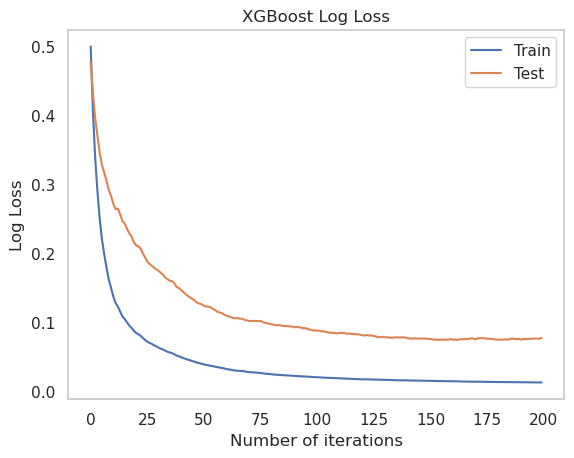

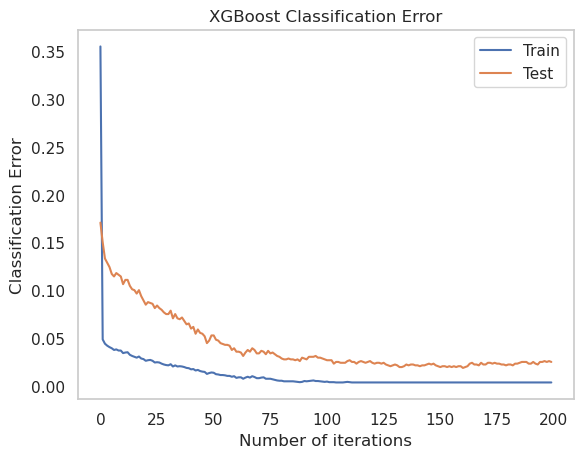

In [97]:
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, classification_report
import matplotlib.pyplot as plt

def train_and_evaluate_XGB(X_train, y_train, X_test, y_test):
    # Define the XGBoost classifier
    clf = XGBClassifier(learning_rate=0.2,
                        max_depth=8,
                        subsample=0.5,
                        reg_alpha=0.1, 
                        reg_lambda=0.01,
                        objective='binary:logistic',
                        n_estimators=200,
                        eval_metric=["logloss", "error"],
                        use_label_encoder=False)

    # Set eval_set for training and validation data
    eval_set = [(X_train, y_train), (X_test, y_test)]
    
    # Fit the model with early stopping (if you want to add it)
    clf.fit(X_train, y_train, eval_set=eval_set, verbose=True)

    # Predict on the test set
    y_pred = clf.predict(X_test)
    predicted_values = [round(val) for val in y_pred]

    # Evaluation metrics
    accuracy = accuracy_score(y_test, predicted_values)
    print("Accuracy: %.2f%%" % (accuracy * 100.0))
    print(classification_report(y_test, y_pred, digits=4))

    # Performance metrics (evals_result)
    results = clf.evals_result()

    # Extract the number of epochs (iterations)
    epochs = len(results['validation_0']['logloss'])
    x_axis = range(0, epochs)

    # Plotting log loss over iterations
    fig, ax = plt.subplots()
    ax.plot(x_axis, results['validation_0']['logloss'], label='Train')
    ax.plot(x_axis, results['validation_1']['logloss'], label='Test')
    ax.legend()
    plt.ylabel('Log Loss')
    plt.xlabel('Number of iterations')
    plt.title('XGBoost Log Loss')
    plt.grid(False)
    plt.show()

    # Plot classification error over iterations
    fig, ax = plt.subplots()
    ax.plot(x_axis, results['validation_0']['error'], label='Train')
    ax.plot(x_axis, results['validation_1']['error'], label='Test')
    ax.legend()
    plt.ylabel('Classification Error')
    plt.xlabel('Number of iterations')
    plt.title('XGBoost Classification Error')
    plt.grid(False)
    plt.show()

    return clf

# Example usage:
best_xgb = train_and_evaluate_XGB(X_train, y_train, X_test, y_test)


In [ ]:
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import StratifiedKFold, GridSearchCV
import numpy as np
import matplotlib.pyplot as plt
import time

def stratified_k_fold_AdaBoost(X, Y, n_folds):
    print("Starting stratified Cross-validation using AdaBoost")

    # AdaBoost classifier with DecisionTree as the base estimator
    base_estimator = DecisionTreeClassifier()
    model = AdaBoostClassifier(estimator=base_estimator)  # Use 'estimator' instead of 'base_estimator'

    # Define the hyperparameters to tune
    n_estimators = [50, 100, 150, 200, 250]
    learning_rate = [0.01, 0.1, 0.2, 0.5, 1.0]
    max_depth = [2, 3, 4, 5, 6]  # max_depth for the base DecisionTree

    param_grid = {
        'n_estimators': n_estimators,
        'learning_rate': learning_rate,
        'estimator__max_depth': max_depth  # Use 'estimator__' to refer to DecisionTreeClassifier parameters
    }

    # Stratified K-Folds cross-validator
    kfold = StratifiedKFold(n_splits=n_folds, shuffle=True, random_state=7)

    # Perform Grid Search with Stratified K-Fold
    results = GridSearchCV(model, param_grid, cv=kfold, scoring='roc_auc', n_jobs=6)

    # Measure time for tuning process
    start_time = time.time()
    grid_result = results.fit(X, Y)

    # Summarize the best result
    print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
    means = grid_result.cv_results_['mean_test_score']
    stds = grid_result.cv_results_['std_test_score']
    params = grid_result.cv_results_['params']

    # Output the results for each combination
    for mean, stdev, param in zip(means, stds, params):
        print("%f (%f) with: %r" % (mean, stdev, param))
    
    print("Execution time: ", time.time() - start_time)

    # Plot results for n_estimators vs AUC for each learning_rate
    scores = np.array(means).reshape(len(max_depth), len(n_estimators))
    for i, depth in enumerate(max_depth):
        plt.plot(n_estimators, scores[i], label='depth: ' + str(depth))
    
    plt.legend()
    plt.xlabel('n_estimators')
    plt.ylabel('AUC')
    plt.title("AUC vs. Number of Estimators for Various Tree Depths in AdaBoost")
    plt.show()

# Example usage
stratified_k_fold_AdaBoost(X_combined, y_combined, 5)

/home/malikcyrus/anaconda3/envs/code-env/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Accuracy: 96.06%
              precision    recall  f1-score   support

           0     0.8621    0.9162    0.8883       191
           1     0.9825    0.9698    0.9761       926

    accuracy                         0.9606      1117
   macro avg     0.9223    0.9430    0.9322      1117
weighted avg     0.9619    0.9606    0.9611      1117



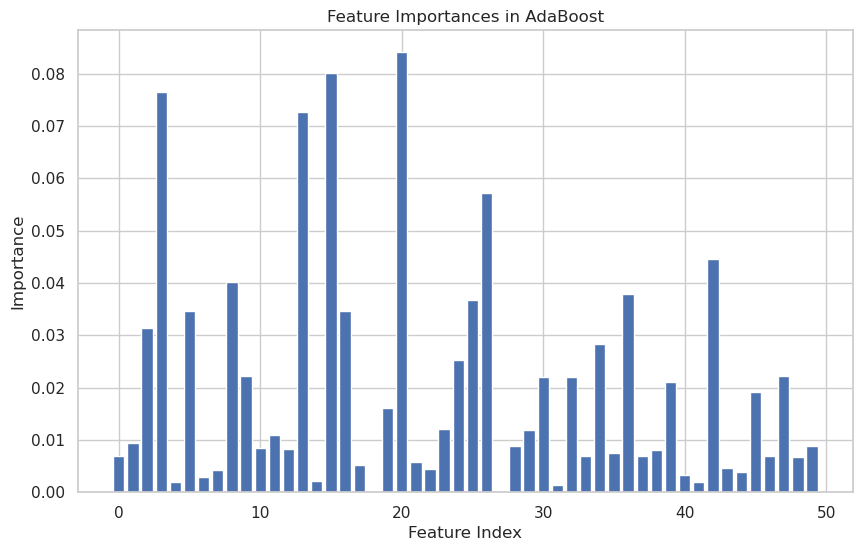

In [91]:
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, classification_report
import matplotlib.pyplot as plt

def train_and_evaluate_AdaBoost(X_train, y_train, X_test, y_test):
    # Define the base estimator (DecisionTreeClassifier) and AdaBoost classifier
    base_estimator = DecisionTreeClassifier(max_depth=2)  # You can tune this value
    clf = AdaBoostClassifier(estimator=base_estimator,
                             n_estimators=200,  # Number of boosting iterations
                             learning_rate=0.2)  # Learning rate for AdaBoost
    
    # Fit the model
    clf.fit(X_train, y_train)

    # Predict on the test set
    y_pred = clf.predict(X_test)
    
    # Evaluation metrics
    accuracy = accuracy_score(y_test, y_pred)
    print("Accuracy: %.2f%%" % (accuracy * 100.0))
    print(classification_report(y_test, y_pred, digits=4))

    # Visualizing Feature Importances (if applicable)
    feature_importances = clf.feature_importances_
    plt.figure(figsize=(10, 6))
    plt.bar(range(len(feature_importances)), feature_importances)
    plt.title('Feature Importances in AdaBoost')
    plt.xlabel('Feature Index')
    plt.ylabel('Importance')
    plt.show()

    return clf

# Example usage:
best_adaboost = train_and_evaluate_AdaBoost(X_train, y_train, X_test, y_test)


/home/malikcyrus/anaconda3/envs/code-env/lib/python3.12/site-packages/sklearn/ensemble/_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Accuracy: 96.87%
              precision    recall  f1-score   support

           0     0.9149    0.9005    0.9077       191
           1     0.9795    0.9827    0.9811       926

    accuracy                         0.9687      1117
   macro avg     0.9472    0.9416    0.9444      1117
weighted avg     0.9685    0.9687    0.9686      1117



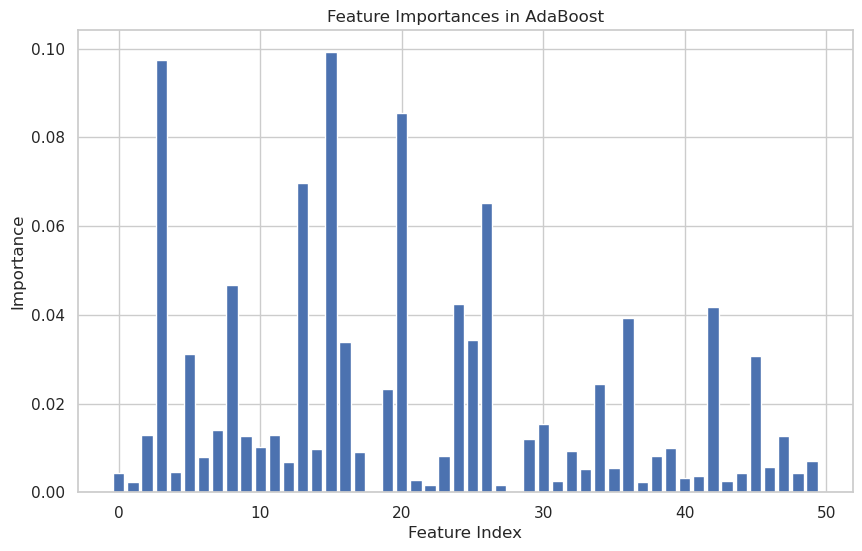

[0]	validation_0-logloss:0.50199	validation_0-error:0.35552	validation_1-logloss:0.47898	validation_1-error:0.17099
[1]	validation_0-logloss:0.40730	validation_0-error:0.04716	validation_1-logloss:0.43301	validation_1-error:0.14145
[2]	validation_0-logloss:0.34052	validation_0-error:0.04507	validation_1-logloss:0.39918	validation_1-error:0.13429
[3]	validation_0-logloss:0.29075	validation_0-error:0.04299	validation_1-logloss:0.37160	validation_1-error:0.12981
[4]	validation_0-logloss:0.25181	validation_0-error:0.04239	validation_1-logloss:0.34700	validation_1-error:0.13071
[5]	validation_0-logloss:0.22140	validation_0-error:0.03940	validation_1-logloss:0.32905	validation_1-error:0.12175
[6]	validation_0-logloss:0.20097	validation_0-error:0.03940	validation_1-logloss:0.32018	validation_1-error:0.12086
[7]	validation_0-logloss:0.18188	validation_0-error:0.03970	validation_1-logloss:0.30985	validation_1-error:0.12355
[8]	validation_0-logloss:0.16417	validation_0-error:0.03821	validation_1

/home/malikcyrus/anaconda3/envs/code-env/lib/python3.12/site-packages/xgboost/core.py:158: UserWarning: [01:17:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


[47]	validation_0-logloss:0.04087	validation_0-error:0.01254	validation_1-logloss:0.12727	validation_1-error:0.05372
[48]	validation_0-logloss:0.04027	validation_0-error:0.01164	validation_1-logloss:0.12629	validation_1-error:0.05013
[49]	validation_0-logloss:0.03936	validation_0-error:0.01254	validation_1-logloss:0.12448	validation_1-error:0.05461
[50]	validation_0-logloss:0.03847	validation_0-error:0.01224	validation_1-logloss:0.12340	validation_1-error:0.05372
[51]	validation_0-logloss:0.03791	validation_0-error:0.01194	validation_1-logloss:0.12257	validation_1-error:0.05192
[52]	validation_0-logloss:0.03730	validation_0-error:0.01075	validation_1-logloss:0.12195	validation_1-error:0.04924
[53]	validation_0-logloss:0.03683	validation_0-error:0.01104	validation_1-logloss:0.12039	validation_1-error:0.04745
[54]	validation_0-logloss:0.03586	validation_0-error:0.01104	validation_1-logloss:0.11788	validation_1-error:0.04745
[55]	validation_0-logloss:0.03515	validation_0-error:0.00985	val

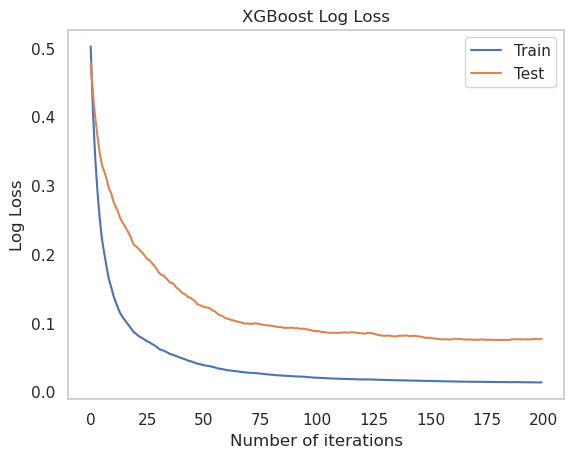

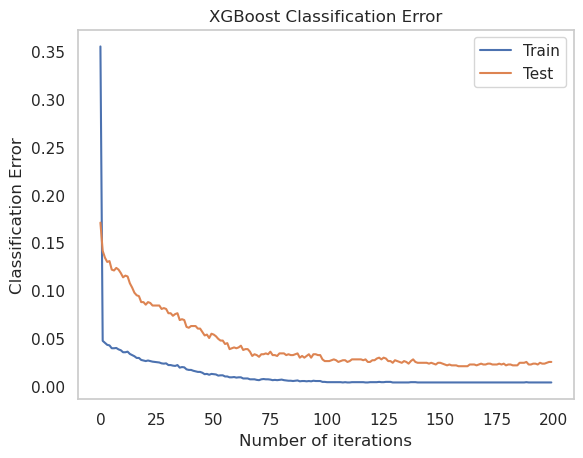

[LightGBM] [Info] Number of positive: 2159, number of negative: 1191
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000663 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 12747
[LightGBM] [Info] Number of data points in the train set: 3350, number of used features: 50
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.644478 -> initscore=0.594852
[LightGBM] [Info] Start training from score 0.594852
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

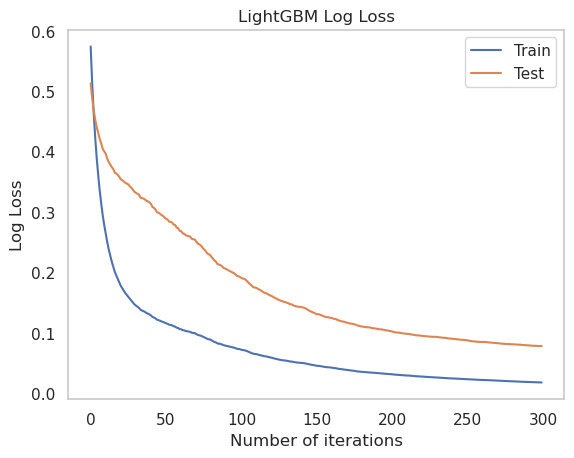

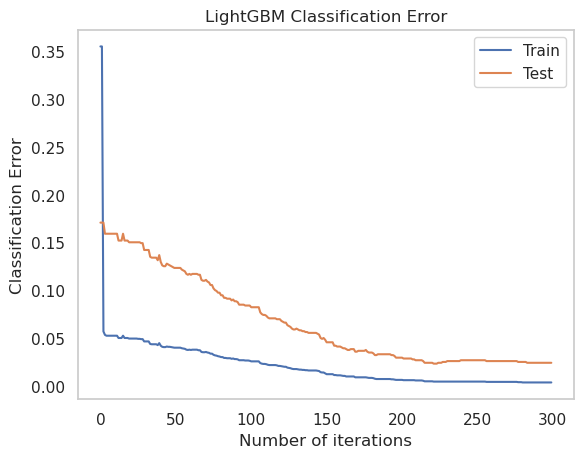

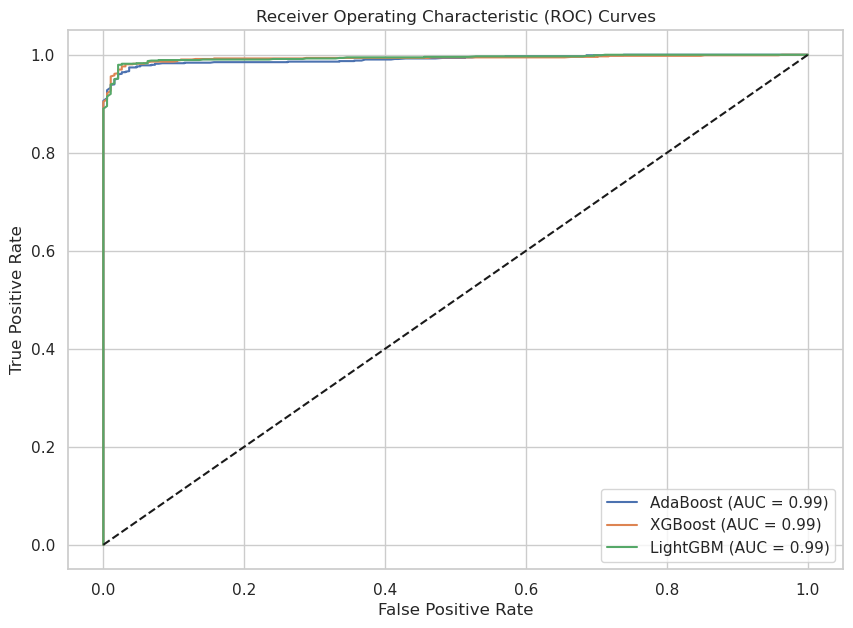

In [136]:
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt

# Define a function to calculate and plot ROC curve
def plot_roc_auc(y_test, y_pred_proba, model_name):
    fpr, tpr, _ = roc_curve(y_test, y_pred_proba)
    roc_auc = auc(fpr, tpr)
    plt.plot(fpr, tpr, label=f'{model_name} (AUC = {roc_auc:.2f})')

# Train and evaluate AdaBoost
best_adaboost = train_and_evaluate_AdaBoost(X_train, y_train, X_test, y_test)
y_adaboost_proba = best_adaboost.predict_proba(X_test)[:, 1]  # Probabilities for class 1

# Train and evaluate XGBoost
best_xgb = train_and_evaluate_XGB(X_train, y_train, X_test, y_test)
y_xgb_proba = best_xgb.predict_proba(X_test)[:, 1]  # Probabilities for class 1

# Train and evaluate LightGBM
best_lgbm = train_and_evaluate_LGBM(X_train, y_train, X_test, y_test)
y_lgbm_proba = best_lgbm.predict_proba(X_test)[:, 1]  # Probabilities for class 1

# Plot ROC curves
plt.figure(figsize=(10, 7))
plot_roc_auc(y_test, y_adaboost_proba, 'AdaBoost')
plot_roc_auc(y_test, y_xgb_proba, 'XGBoost')
plot_roc_auc(y_test, y_lgbm_proba, 'LightGBM')

plt.plot([0, 1], [0, 1], 'k--')  # Diagonal line
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curves')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()
